## Part I : Global includes



In [1]:

%matplotlib inline
import warnings
warnings.filterwarnings("ignore")

import os
import pathlib
from matplotlib import pyplot as plt
import torch
import numpy as np
import cv2
import tensorflow as tf
from pyemd.EMD2d import EMD2D
emd2d = EMD2D()

# Uncomment to disable GPU usage.
# This is required for some models like Pridnet which has too many traininable parameters
tf.config.set_visible_devices([], 'GPU')

from tqdm.notebook import tqdm
import random

import data_importer

In [2]:
from tensorflow.compat.v1 import ConfigProto
from tensorflow.compat.v1 import InteractiveSession

config = ConfigProto()
config.gpu_options.allow_growth = True
session = InteractiveSession(config=config)

## Part II : Loading test images

In [3]:
#from sklearn.model_selection import train_test_split
from data_importer import load_training_images

noisy_array, gt_array = load_training_images('../../../../Dataset/LowDoseCTGrandChallenge/Training_Image_Data/', load_limited_images=True, num_images_to_load=5)

_n, _g = load_training_images('../../../../Dataset/LowDoseCTGrandChallenge/Selected_Image_Pairs/', load_limited_images=False, num_images_to_load=1)

noisy_array = np.concatenate((noisy_array, _n), axis=0)
gt_array = np.concatenate((gt_array, _g), axis=0)

extended_noisy_array, extended_gt_array = load_training_images('../../../../Dataset/LowDoseCTGrandChallenge/Training_Image_Data/', load_limited_images=True, num_images_to_load=100)

loaded training images x and y of len :  5 5  respectively
type of train images x :  float64
range of values in train images :  0.0 0.576171875
type of train images y :  float64
loaded training images x and y of len :  3 3  respectively
type of train images x :  float64
range of values in train images :  0.0 0.654541015625
type of train images y :  float64
loaded training images x and y of len :  100 100  respectively
type of train images x :  float64
range of values in train images :  0.0 0.576171875
type of train images y :  float64


Visualization of the noisy / ground truth image pair

In [4]:
from data_importer import denormalize, trunc

for i in range(6, 0, 3):
    f, axarr = plt.subplots(1,2, figsize=(14,14))
    axarr[0].imshow(trunc(denormalize(noisy_array[i])), vmin=-160.0, vmax=240.0, cmap='gray')
    axarr[0].set_title("Noisy image (QD)")
    axarr[1].imshow(trunc(denormalize(gt_array[i])), vmin=-160.0, vmax=240.0, cmap='gray')
    axarr[1].title.set_text("Ground Truth image (FD)")
    plt.show()

### Part III : Setup for Inference

In [5]:
# Inference
def inference_single_image(model, noisy_image):
    input_image = np.expand_dims(noisy_image, axis=0)
    predicted_image = model.predict(input_image)
    a = np.abs(np.min(predicted_image))
    b = np.max(predicted_image)
    
    #predicted_image = predicted_image * (b - a) + a
    return predicted_image[0]

def inference_batch_images(model, noisy_images):
    input_image = noisy_images

    predicted_image = model.predict(input_image).astype(np.float64)
    return predicted_image

In [6]:
def rgb2gray(rgb):
    return np.expand_dims(np.dot(rgb[...,:3], [0.2989, 0.5870, 0.1140]), axis=-1)

from skimage.metrics import structural_similarity as ssim
from skimage.metrics import peak_signal_noise_ratio
import sys
sys.path.append('../')

from metrics import compute_SSIM, compute_PSNR
from skimage.metrics import mean_squared_error  as mse

def calculate_psnr(original_image, reconstructed_image,range=400):
    return peak_signal_noise_ratio(original_image, reconstructed_image,data_range=range) 

    psnr_value = peak_signal_noise_ratio(original_image, reconstructed_image, data_range=240+160)
    return psnr_value

def calculate_ssim(original_image, reconstructed_image, range=400.0):    
    ssim_value = ssim(original_image.astype(np.int16), reconstructed_image.astype(np.int16), win_size=11, channel_axis=2, data_range=range)
    return ssim_value

def calculate_rmse(original_image, reconstructed_image):
    return mse(original_image, reconstructed_image)

def visualize_predictions(model, X_test, y_test, n, predictions, model_name):
    random_numbers = list(range(n)) # not very random
    for i in random_numbers:
        noisy_image = X_test[i].astype(np.float16)
        gt_image = y_test[i].astype(np.float16)
        predicted_image = predictions[i].astype(np.float16)

        if predicted_image.shape[-1] == 3:
            predicted_image = rgb2gray(predicted_image)
                                
            
        psnr_recon =  calculate_psnr(trunc(denormalize(gt_image)), trunc(denormalize(predicted_image)))
        psnr_qd =  calculate_psnr(trunc(denormalize(gt_image)),  trunc(denormalize(noisy_image)))
        ssim_recon = calculate_ssim(trunc(denormalize(gt_image)),  trunc(denormalize(predicted_image)))
        ssim_qd =calculate_ssim(trunc(denormalize(gt_image)), trunc(denormalize(noisy_image)))
        rmse_recon = calculate_rmse(trunc(denormalize(gt_image)),  trunc(denormalize(predicted_image)))
        rmse_qd=calculate_rmse(trunc(denormalize(gt_image)), trunc(denormalize(noisy_image)))
        
        psnr_recon = round(psnr_recon, 4)
        psnr_qd = round(psnr_qd, 4)
        ssim_recon = round(ssim_recon, 4)
        ssim_qd = round(ssim_qd, 4)
        rmse_recon = round(rmse_recon, 4)
        rmse_qd = round(rmse_qd, 4)
        
        f, axarr = plt.subplots(1,3, figsize=(21,21))

        axarr[0].imshow(trunc(denormalize(noisy_image)), cmap='gray', vmin=-160.0, vmax=240.0)
        axarr[0].set_title("QD Image : PSNR={}\nSSIM={}\nRMSE={}".format(psnr_qd, ssim_qd, rmse_qd))
        axarr[0].set_axis_off()
        axarr[1].imshow(trunc(denormalize(gt_image)),  cmap='gray', vmin=-160.0, vmax=240.0)
        axarr[1].set_title("FD Image")
        axarr[1].set_axis_off()
        axarr[2].imshow(trunc(denormalize(predicted_image)), cmap='gray', vmin=-160.0, vmax=240.0)
        axarr[2].set_title("{} Predicted Image : PSNR={}\nSSIM={}\nRMSE={}".format(model_name, psnr_recon, ssim_recon, rmse_recon))
        axarr[2].set_axis_off()
        
        plt.show()

In [7]:
from skimage.metrics import peak_signal_noise_ratio

def get_average_metrics(predicted_images, _gt_array, _noisy_array):
    psnr_original_mean = 0
    psnr_prediction_mean = 0

    ssim_original_mean = 0
    ssim_prediction_mean = 0

    mse_original_mean = 0
    mse_prediction_mean = 0

    if np.all(_gt_array) != None:
        gt_array = _gt_array
        noisy_array = _noisy_array
        

    i = 0
    for gt_img, noisy_img, predicted_img in zip(gt_array, noisy_array, predicted_images):
        predicted_img=  predicted_images[i]
        if predicted_img.shape[-1] == 3:
            predicted_img = rgb2gray(predicted_img)
            
        psnr_recon =  calculate_psnr(trunc(denormalize(gt_img)), trunc(denormalize(predicted_img)))
        psnr_qd =  calculate_psnr(trunc(denormalize(gt_img)),  trunc(denormalize(noisy_img)))
        ssim_recon = calculate_ssim(trunc(denormalize(gt_img)),  trunc(denormalize(predicted_img)))
        ssim_qd =calculate_ssim(trunc(denormalize(gt_img)), trunc(denormalize(noisy_img)))
        rmse_recon = calculate_rmse(trunc(denormalize(gt_img)),  trunc(denormalize(predicted_img)))
        rmse_qd=calculate_rmse(trunc(denormalize(gt_img)), trunc(denormalize(noisy_img)))

        psnr_original_mean += psnr_qd
        psnr_prediction_mean += psnr_recon
        
        ssim_original_mean += ssim_qd
        ssim_prediction_mean += ssim_recon

        mse_original_mean += rmse_qd
        mse_prediction_mean += rmse_recon
        
        i = i + 1        
    
    psnr_original_mean/=gt_array.shape[0]
    psnr_prediction_mean/=gt_array.shape[0]

    ssim_original_mean/=gt_array.shape[0]
    ssim_prediction_mean/=gt_array.shape[0]

    mse_original_mean/=gt_array.shape[0]
    mse_prediction_mean/=gt_array.shape[0]
    
    print("Original average gt-noisy PSNR ->", psnr_original_mean)
    print("Predicted average gt-predicted PSNR ->", psnr_prediction_mean)

    print("Original average gt-noisy SSIM ->", ssim_original_mean)
    print("Predicted average gt-predicted SSIM ->", ssim_prediction_mean)

    print("Original average gt-noisy MSE->", mse_original_mean)
    print("Predicted average gt-predicted MSE->", mse_prediction_mean)
    
    return round(psnr_prediction_mean, 4), round(ssim_prediction_mean, 4), round(mse_prediction_mean, 4), round(psnr_prediction_mean - psnr_original_mean, 4), round(ssim_prediction_mean - ssim_original_mean, 4), round(mse_prediction_mean - mse_original_mean, 4)


## Part IV : Evaluation of each model

## Model 1 : Hformer (for base reference)

In [8]:
sys.path.append('../denoising-models/hformer_vit/model/')
sys.path.append('../denoising-models/hformer_vit/')
from hformer_model_extended import get_hformer_model, PatchExtractor

hformer_model = get_hformer_model(num_channels_to_be_generated=64, name="hformer_model_extended")
hformer_model.build(input_shape=(None, 64, 64, 1))
hformer_model.load_weights('../denoising-models/hformer_vit/test/experiments/full_dataset/hformer_64_channel_custom_loss_epochs_48.h5')
print('Model summary : ')
print(hformer_model.summary())

Model summary : 
Model: "hformer_model_extended"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_projection_layer (Inp  multiple                 320       
 utProjectionLayer)                                              
                                                                 
 output_projection_layer (Ou  multiple                 257       
 tputProjectionLayer)                                            
                                                                 
 conv_net_block_1 (Convoluti  multiple                 36416     
 onBlock)                                                        
                                                                 
 conv_net_block_2 (Convoluti  multiple                 36416     
 onBlock)                                                        
                                                                 
 downsampling_layer_1 (Conv

In [9]:
def reconstruct_image_from_patches(patches, num_patches_per_row):
    patch_size = patches.shape[1]  # Assuming square patches
    num_patches = patches.shape[0]

    # Calculate the number of rows
    num_patches_per_col = num_patches // num_patches_per_row

    # Initialize an empty image to store the reconstructed result
    reconstructed_image = np.zeros((num_patches_per_col * patch_size, num_patches_per_row * patch_size))

    # Reshape the patches into a 2D array
    patches_2d = patches.reshape((num_patches_per_col, num_patches_per_row, patch_size, patch_size))
    # Reconstruct the image by placing each patch in its corresponding position

    for i in range(num_patches_per_col):
        for j in range(num_patches_per_row):
            reconstructed_image[i * patch_size:(i + 1) * patch_size, j * patch_size:(j + 1) * patch_size] = patches_2d[i, j]

    return np.expand_dims(reconstructed_image, axis=-1)

In [10]:
# View the predictions
patch_extractor = PatchExtractor(patch_size=64, stride=64, name="patch_extractor")
noisy_image_patches_array = patch_extractor(noisy_array)
extended_noisy_image_patches_array = patch_extractor(extended_noisy_array)


In [11]:
from pytorch_wavelets import DTCWTForward, DTCWTInverse
dwt = DTCWTForward(J=3).cuda()
idwt = DTCWTInverse().cuda()

200/200 [==============================] - 188s 942ms/step


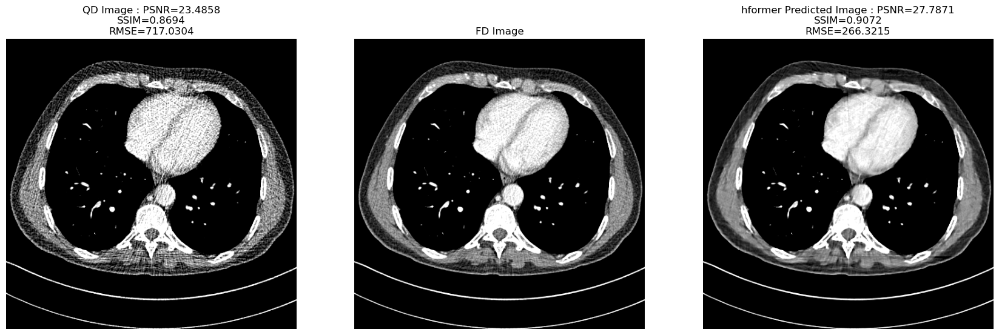

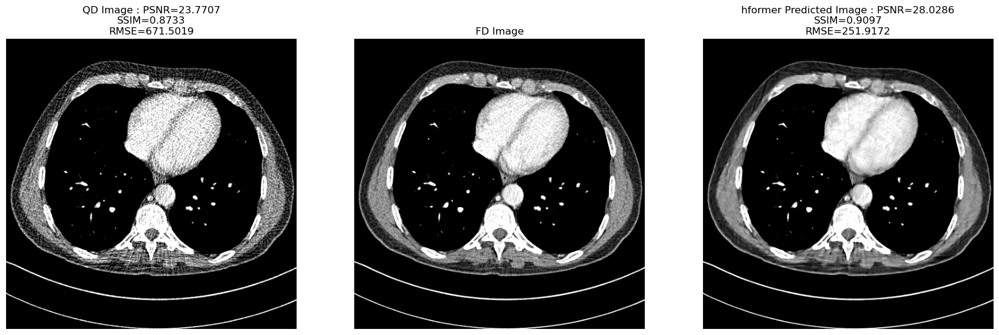

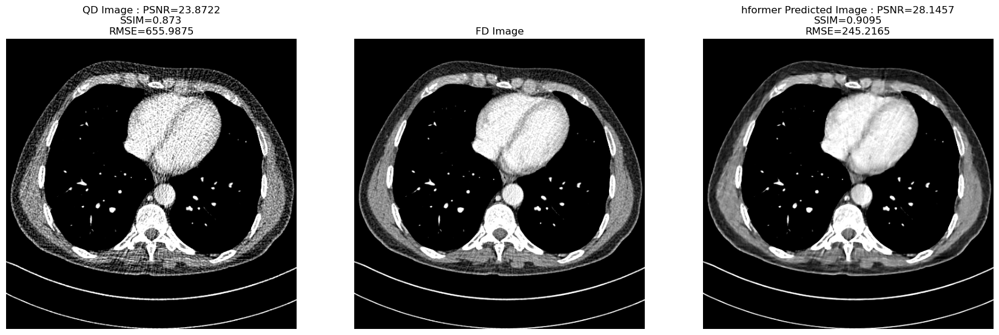

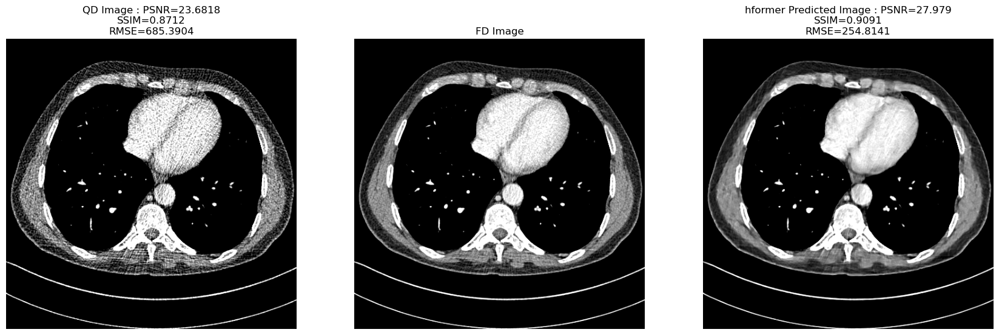

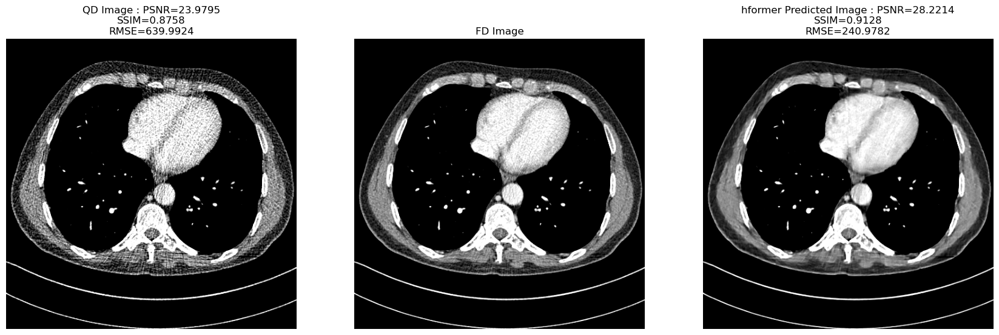

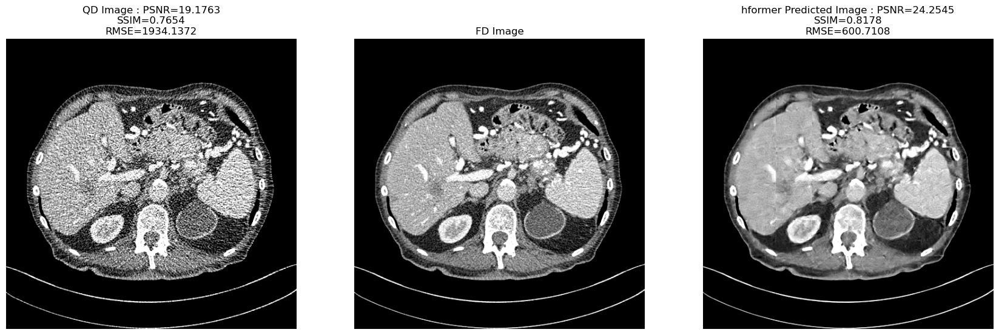

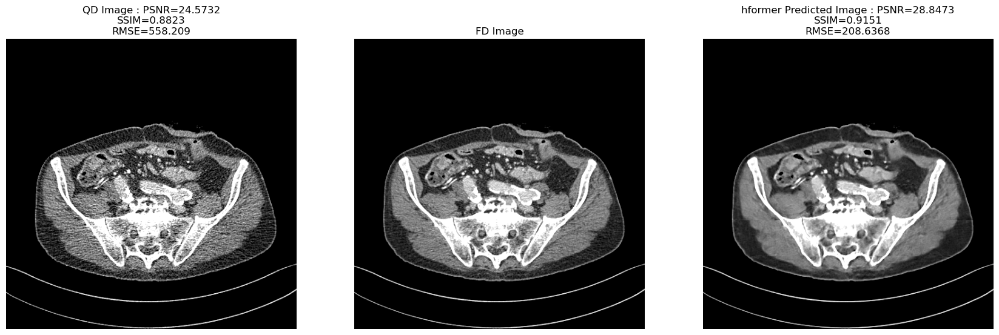

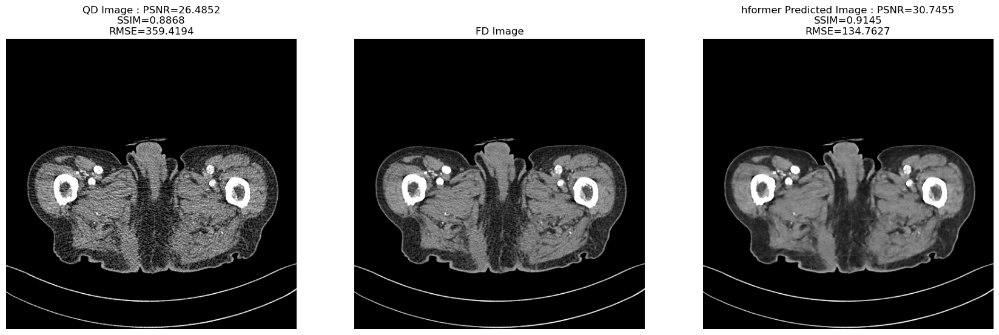

In [12]:

hformer_prediction_patches = hformer_model.predict(noisy_image_patches_array)
extended_hformer_prediction_patches = hformer_model.predict(extended_noisy_image_patches_array)

hformer_predictions = np.expand_dims(reconstruct_image_from_patches(hformer_prediction_patches[0:64], 8), axis=0)
extended_hformer_predictions = np.expand_dims(reconstruct_image_from_patches(extended_hformer_prediction_patches[0:64], 8), axis=0)

for i in range(1, int(hformer_prediction_patches.shape[0] / 64)): 
    reconstructed_image = reconstruct_image_from_patches(hformer_prediction_patches[i * 64 : i * 64 + 64], num_patches_per_row=8)
    reconstructed_image = np.expand_dims(reconstructed_image, axis=0)

    hformer_predictions = np.append(hformer_predictions, reconstructed_image, axis=0)

for i in range(1, int(extended_hformer_prediction_patches.shape[0] / 64)): 
    extended_reconstructed_image = reconstruct_image_from_patches(extended_hformer_prediction_patches[i * 64 : i * 64 + 64], num_patches_per_row=8)
    extended_reconstructed_image = np.expand_dims(extended_reconstructed_image, axis=0)

    extended_hformer_predictions = np.append(extended_hformer_predictions, extended_reconstructed_image, axis=0)
visualize_predictions(hformer_predictions, noisy_array, gt_array, len(gt_array), hformer_predictions, "hformer")

In [13]:
extended_hformer_metrics = get_average_metrics(extended_hformer_predictions, extended_gt_array, extended_noisy_array)
extended_hformer_metrics 

Original average gt-noisy PSNR -> 22.75797969597923
Predicted average gt-predicted PSNR -> 27.523600831115917
Original average gt-noisy SSIM -> 0.82834844080363
Predicted average gt-predicted SSIM -> 0.8723555743844719
Original average gt-noisy MSE-> 937.7143929672242
Predicted average gt-predicted MSE-> 304.4095022895431


(27.5236, 0.8724, 304.4095, 4.7656, 0.044, -633.3049)

## Model 2 : XModel B

In [14]:
from torchinfo import summary
sys.path.append('../denoising-models/novel_model/')
from xb_denoiser_with_hf_conv import XModel 
x_model = XModel(num_channels=1)
x_model.load_state_dict(torch.load('../denoising-models/novel_model_weights/xb_hf_model_889.pth'))
x_model.eval()
print('Model summary : ')
print(summary(x_model))


Model summary : 
Layer (type:depth-idx)                        Param #
XModel                                        --
├─ConvTranspose2d: 1-1                        5
├─Conv2d: 1-2                                 5
├─InputProjectionLayer: 1-3                   --
├─OutputProjectionLayer: 1-4                  --
├─ConvBlock: 1-5                              --
│    └─ZeroPad2d: 2-1                         --
│    └─DepthWiseSeparableConv2d: 2-2          --
│    │    └─Conv2d: 3-1                       49
│    │    └─Conv2d: 3-2                       1
│    └─LayerNorm: 2-3                         --
│    └─Conv2d: 2-4                            200
│    └─GELU: 2-5                              --
│    └─Conv2d: 2-6                            5
├─ConvBlock: 1-6                              --
│    └─ZeroPad2d: 2-7                         --
│    └─DepthWiseSeparableConv2d: 2-8          --
│    │    └─Conv2d: 3-3                       49
│    │    └─Conv2d: 3-4                       1
│ 

torch.Size([1, 512, 512, 1])
torch.Size([1, 512, 512, 1])
torch.Size([1, 512, 512, 1])
torch.Size([1, 512, 512, 1])
torch.Size([1, 512, 512, 1])
torch.Size([1, 512, 512, 1])
torch.Size([1, 512, 512, 1])
torch.Size([1, 512, 512, 1])
torch.Size([1, 512, 512, 1])
ot shape :  torch.Size([1, 1, 512, 512])  noisy shape :  torch.Size([1, 1, 512, 512])
recon torch.Size([1, 1, 512, 512])
recon torch.Size([1, 512, 512, 1])
torch.Size([1, 512, 512, 1])
ot shape :  torch.Size([1, 1, 512, 512])  noisy shape :  torch.Size([1, 1, 512, 512])
recon torch.Size([1, 1, 512, 512])
recon torch.Size([1, 512, 512, 1])
torch.Size([1, 512, 512, 1])
ot shape :  torch.Size([1, 1, 512, 512])  noisy shape :  torch.Size([1, 1, 512, 512])
recon torch.Size([1, 1, 512, 512])
recon torch.Size([1, 512, 512, 1])
torch.Size([1, 512, 512, 1])
ot shape :  torch.Size([1, 1, 512, 512])  noisy shape :  torch.Size([1, 1, 512, 512])
recon torch.Size([1, 1, 512, 512])
recon torch.Size([1, 512, 512, 1])
torch.Size([1, 512, 512, 1])

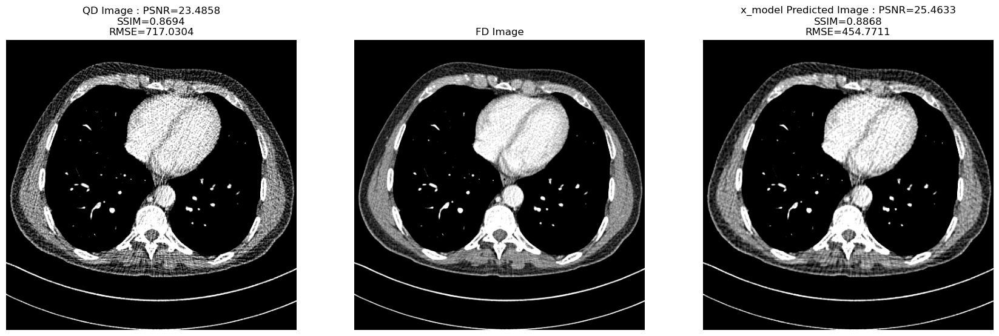

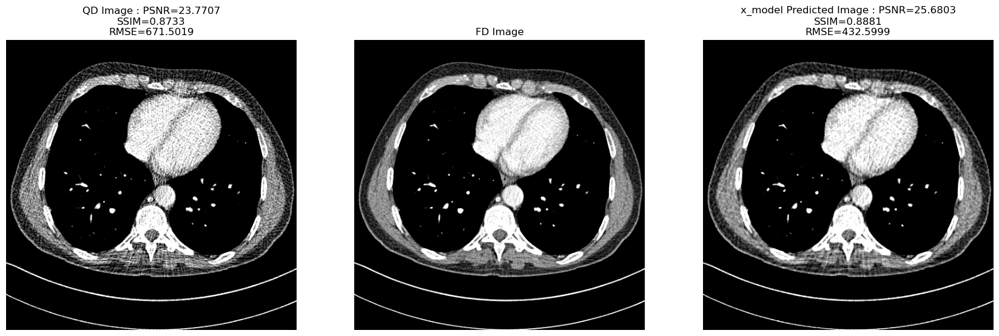

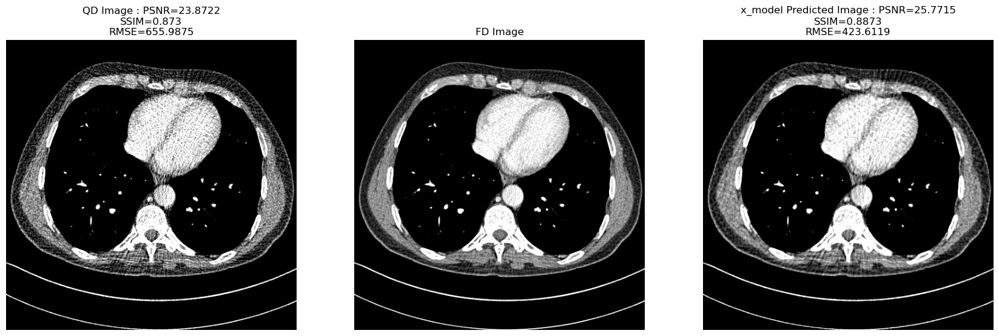

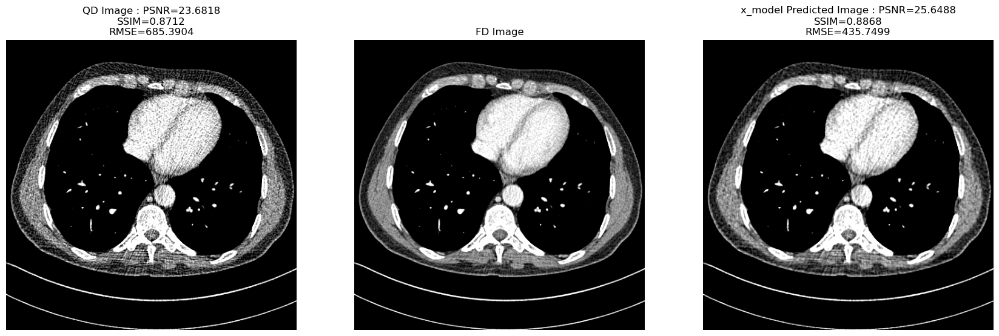

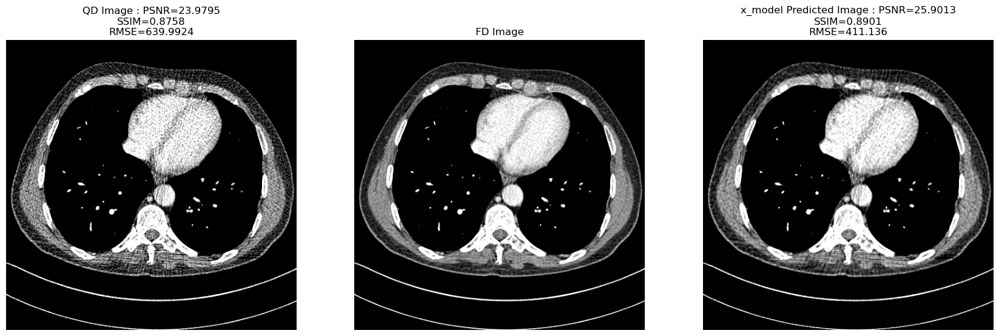

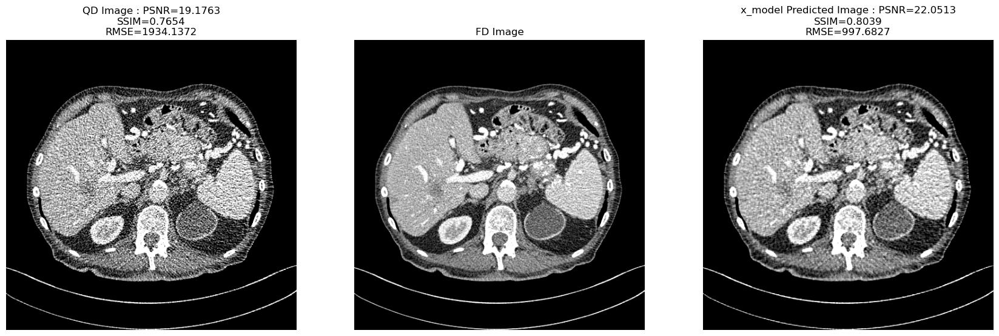

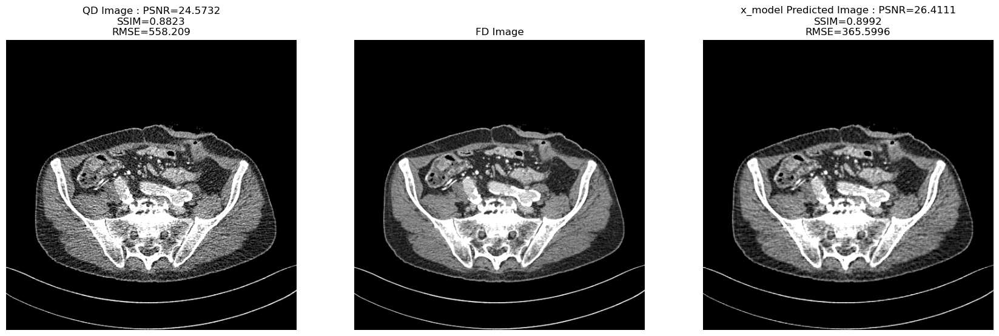

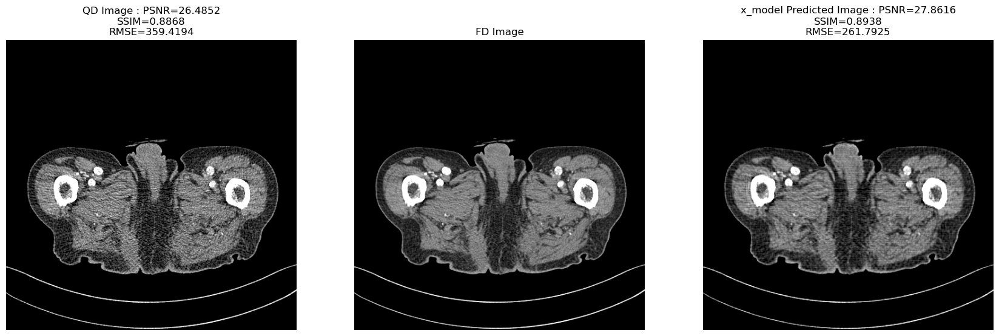

In [15]:
# Get prediction images.

x_model_prediction_patches = []
extended_x_model_prediction_patches = []

for img in noisy_array:
    img_tensor = torch.unsqueeze(torch.from_numpy(img).float(), 0)

    with torch.no_grad():
        output_tensor = x_model(img_tensor)
        output_tensor = output_tensor.cpu().numpy()

        x_model_prediction_patches.append(output_tensor)
    
for i, img in enumerate(extended_noisy_array):
    img_tensor = torch.unsqueeze(torch.from_numpy(img).float(), 0)

    with torch.no_grad():

        output_tensor = x_model(img_tensor)
        _ot = output_tensor
        output_tensor = output_tensor.cpu().numpy()


        _ot = torch.transpose(_ot, 1, 3)
        noisy = torch.from_numpy(np.expand_dims(extended_noisy_array[i], axis=-1).astype(np.float32)).to('cuda')
        noisy = torch.transpose(noisy, 1, 3)
        noisy = torch.transpose(noisy, 0, 2)

        print('ot shape : ', _ot.shape, ' noisy shape : ', noisy.shape)


        prediction_approx, prediction_high_freq = dwt(_ot.cuda())
        prediction_high_freq_low, prediction_high_freq_mid, prediction_high_freq_coarse = prediction_high_freq[0], prediction_high_freq[1], prediction_high_freq[2]

        noisy_approx, noisy_high_freq = dwt(noisy)

        noisy_high_freq_fine, noisy_high_freq_mid, noisy_high_freq_coarse = noisy_high_freq[0], noisy_high_freq[1] , noisy_high_freq[2]

        reconstructed_prediction_image_with_high_freq_swap = idwt((noisy_approx, noisy_high_freq))
        reconstructed_prediction_image_with_high_freq_swap = torch.transpose(reconstructed_prediction_image_with_high_freq_swap, 3, 1)


        #denoise_high_freq = torch.transpose(torch.from_numpy(denoised_high_freq), 1, 3)
        #denoised_noisy_approx, denoised_high_freq = dwt(denoise_high_freq.cuda())
        #noisy_high_freq_fine, noisy_high_freq_mid, noisy_high_freq_coarse = denoised_high_freq[0], denoised_high_freq[1] , denoised_high_freq[2]

        wavelet_high_freq_swapped = [None] * 3
        wavelet_high_freq_swapped[0] =noisy_high_freq_fine
        wavelet_high_freq_swapped[1] =prediction_high_freq_mid
        wavelet_high_freq_swapped[2] =prediction_high_freq_coarse

        reconstructed_prediction_image = idwt((prediction_approx,wavelet_high_freq_swapped))
        print('recon', reconstructed_prediction_image.shape)
        reconstructed_prediction_image = torch.transpose(reconstructed_prediction_image, 1, 3)
        print('recon', reconstructed_prediction_image.shape)
        extended_x_model_prediction_patches.append(reconstructed_prediction_image.detach().cpu().numpy())

visualize_predictions(x_model, noisy_array, gt_array, len(gt_array), np.concatenate(x_model_prediction_patches,axis=0), "x_model")

In [16]:

print(np.concatenate(extended_x_model_prediction_patches, axis=0).shape, extended_gt_array.shape, extended_noisy_array.shape)
extended_x_metrics= get_average_metrics(np.concatenate(extended_x_model_prediction_patches, axis=0), extended_gt_array, extended_noisy_array)
extended_x_metrics

(100, 512, 512, 1) (100, 512, 512, 1) (100, 512, 512, 1)
Original average gt-noisy PSNR -> 22.75797969597923
Predicted average gt-predicted PSNR -> 23.929090608813066
Original average gt-noisy SSIM -> 0.82834844080363
Predicted average gt-predicted SSIM -> 0.8255393953438191
Original average gt-noisy MSE-> 937.7143929672242
Predicted average gt-predicted MSE-> 696.589259221967


(23.9291, 0.8255, 696.5893, 1.1711, -0.0028, -241.1251)

## Model 3 : Y model B

In [17]:
sys.path.append('../denoising-models/mwcnn/')
from yb_denoiser import YModel
y_model = YModel(num_channels=4)
y_model.load_state_dict(torch.load('../denoising-models/novel_model_weights/yb_model_203.pth'))
y_model.eval()
print('Model summary : ')
print(summary(y_model))

Model summary : 
Layer (type:depth-idx)                        Param #
YModel                                        --
├─InputProjectionLayer: 1-1                   --
│    └─Conv2d: 2-1                            40
├─OutputProjectionLayer: 1-2                  --
│    └─ConvTranspose2d: 2-2                   37
├─ConvBlock: 1-3                              --
│    └─ZeroPad2d: 2-3                         --
│    └─DepthWiseSeparableConv2d: 2-4          --
│    │    └─Conv2d: 3-1                       196
│    │    └─Conv2d: 3-2                       16
│    └─LayerNorm: 2-5                         --
│    └─Conv2d: 2-6                            3,152
│    └─GELU: 2-7                              --
│    └─Conv2d: 2-8                            68
├─YBlock: 1-4                                 --
│    └─Linear: 2-9                            20
│    └─Linear: 2-10                           20
│    └─Linear: 2-11                           20
│    └─Conv2d: 2-12                        

ot shape :  torch.Size([1, 1, 512, 512])  noisy shape :  torch.Size([1, 1, 512, 512])
recon torch.Size([1, 1, 512, 512])
recon torch.Size([1, 512, 512, 1])
ot shape :  torch.Size([1, 1, 512, 512])  noisy shape :  torch.Size([1, 1, 512, 512])
recon torch.Size([1, 1, 512, 512])
recon torch.Size([1, 512, 512, 1])
ot shape :  torch.Size([1, 1, 512, 512])  noisy shape :  torch.Size([1, 1, 512, 512])
recon torch.Size([1, 1, 512, 512])
recon torch.Size([1, 512, 512, 1])
ot shape :  torch.Size([1, 1, 512, 512])  noisy shape :  torch.Size([1, 1, 512, 512])
recon torch.Size([1, 1, 512, 512])
recon torch.Size([1, 512, 512, 1])
ot shape :  torch.Size([1, 1, 512, 512])  noisy shape :  torch.Size([1, 1, 512, 512])
recon torch.Size([1, 1, 512, 512])
recon torch.Size([1, 512, 512, 1])
ot shape :  torch.Size([1, 1, 512, 512])  noisy shape :  torch.Size([1, 1, 512, 512])
recon torch.Size([1, 1, 512, 512])
recon torch.Size([1, 512, 512, 1])
ot shape :  torch.Size([1, 1, 512, 512])  noisy shape :  torch.S

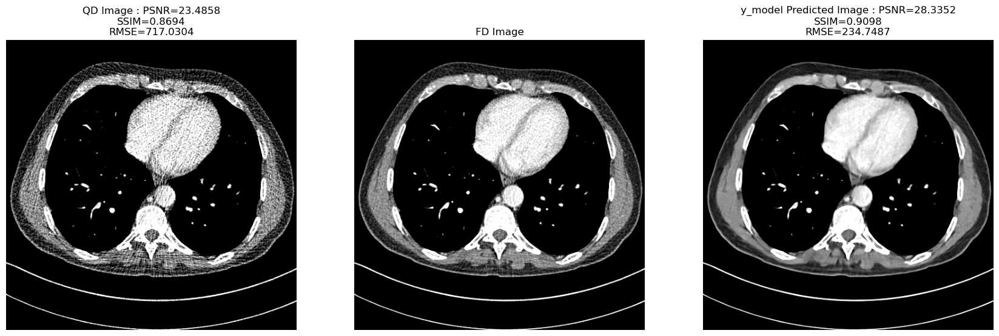

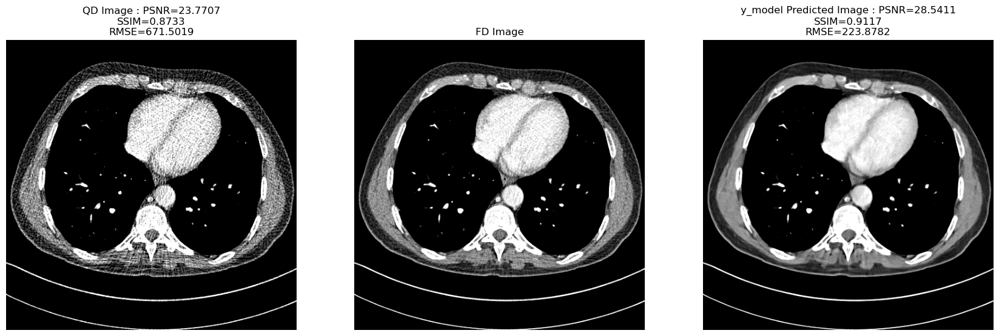

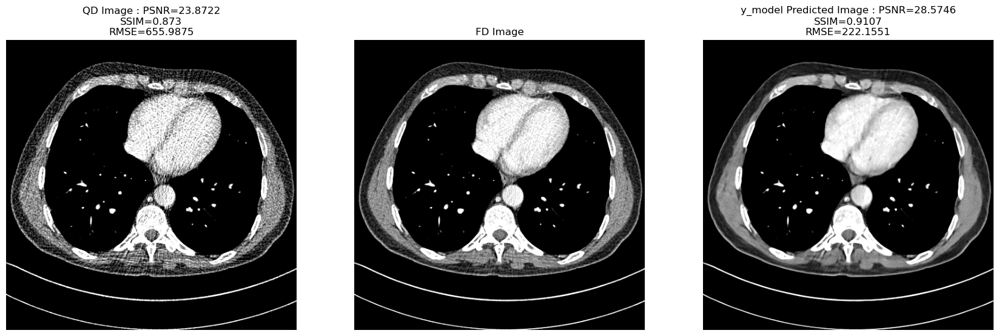

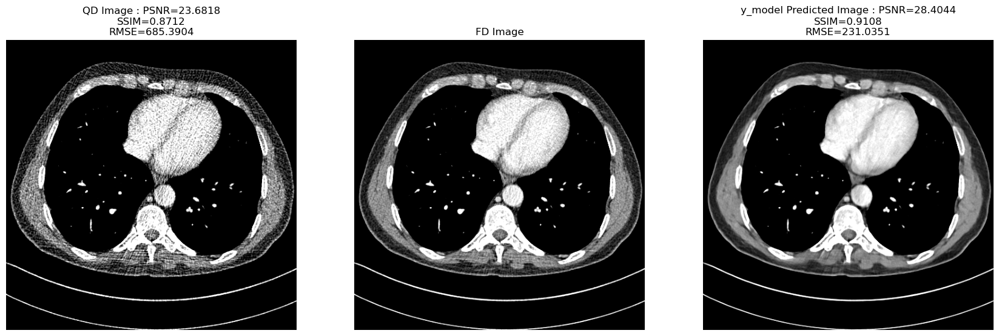

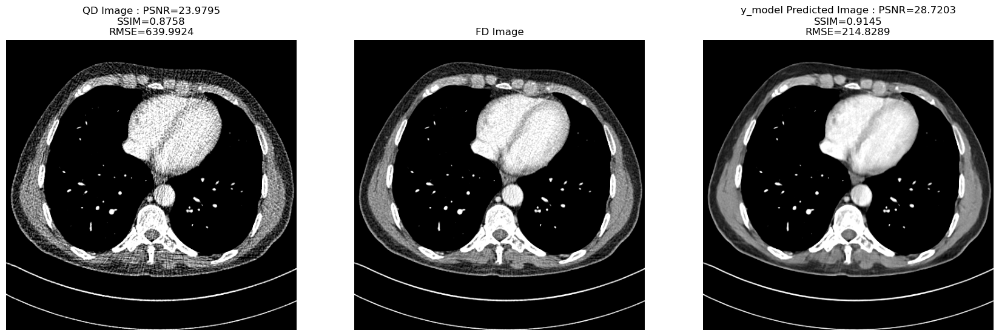

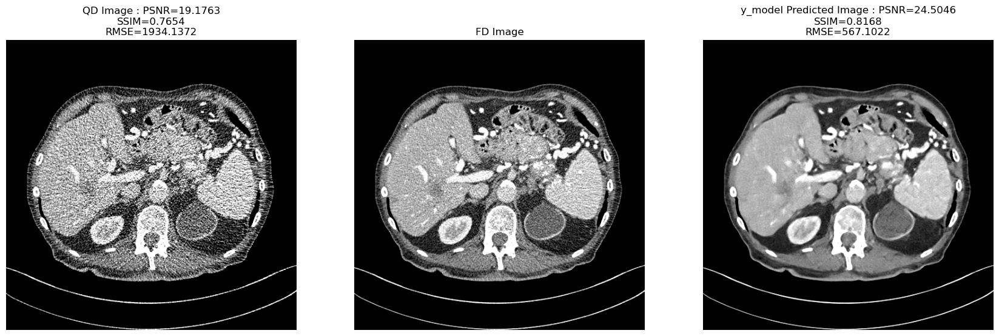

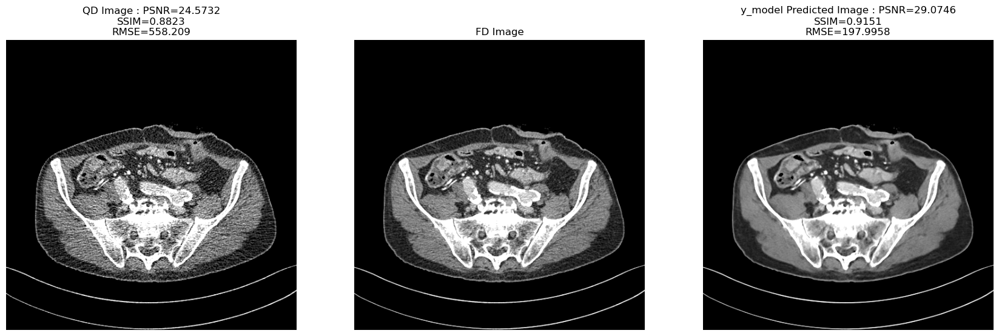

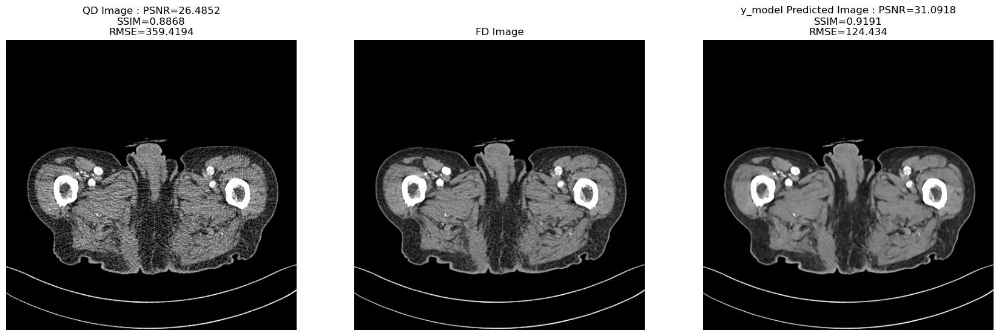

In [18]:
# Get prediction images.

y_model_prediction_patches = []
extended_y_model_prediction_patches = []

for img in noisy_array:
    img_tensor = torch.unsqueeze(torch.from_numpy(img).float(), dim=0)

    
    with torch.no_grad():
        output_tensor = y_model(img_tensor)
        output_tensor = output_tensor.cpu().numpy()

        y_model_prediction_patches.append(output_tensor)
    
   
for i, img in enumerate(extended_noisy_array):
    img_tensor = torch.unsqueeze(torch.from_numpy(img).float(), 0)

    with torch.no_grad():

        output_tensor = y_model(img_tensor)
        _ot = output_tensor
        output_tensor = output_tensor.cpu().numpy()


        _ot = torch.transpose(_ot, 1, 3)
        noisy = torch.from_numpy(np.expand_dims(extended_noisy_array[i], axis=-1).astype(np.float32)).to('cuda')
        noisy = torch.transpose(noisy, 1, 3)
        noisy = torch.transpose(noisy, 0, 2)

        print('ot shape : ', _ot.shape, ' noisy shape : ', noisy.shape)


        prediction_approx, prediction_high_freq = dwt(_ot.cuda())
        prediction_high_freq_low, prediction_high_freq_mid, prediction_high_freq_coarse = prediction_high_freq[0], prediction_high_freq[1], prediction_high_freq[2]

        noisy_approx, noisy_high_freq = dwt(noisy)

        noisy_high_freq_fine, noisy_high_freq_mid, noisy_high_freq_coarse = noisy_high_freq[0], noisy_high_freq[1] , noisy_high_freq[2]

        reconstructed_prediction_image_with_high_freq_swap = idwt((noisy_approx, noisy_high_freq))
        reconstructed_prediction_image_with_high_freq_swap = torch.transpose(reconstructed_prediction_image_with_high_freq_swap, 3, 1)


        #denoise_high_freq = torch.transpose(torch.from_numpy(denoised_high_freq), 1, 3)
        #denoised_noisy_approx, denoised_high_freq = dwt(denoise_high_freq.cuda())
        #noisy_high_freq_fine, noisy_high_freq_mid, noisy_high_freq_coarse = denoised_high_freq[0], denoised_high_freq[1] , denoised_high_freq[2]

        wavelet_high_freq_swapped = [None] * 3
        wavelet_high_freq_swapped[0] =noisy_high_freq_fine
        wavelet_high_freq_swapped[1] =prediction_high_freq_mid
        wavelet_high_freq_swapped[2] =prediction_high_freq_coarse

        reconstructed_prediction_image = idwt((prediction_approx,wavelet_high_freq_swapped))
        print('recon', reconstructed_prediction_image.shape)
        reconstructed_prediction_image = torch.transpose(reconstructed_prediction_image, 1, 3)
        print('recon', reconstructed_prediction_image.shape)
        extended_y_model_prediction_patches.append(reconstructed_prediction_image.detach().cpu().numpy())

visualize_predictions(y_model, noisy_array, gt_array, len(gt_array), np.concatenate(y_model_prediction_patches,axis=0), "y_model")

In [19]:

extended_y_metrics= get_average_metrics(np.concatenate(extended_y_model_prediction_patches, axis=0), extended_gt_array, extended_noisy_array)
extended_y_metrics

Original average gt-noisy PSNR -> 22.75797969597923
Predicted average gt-predicted PSNR -> 25.303333326981488
Original average gt-noisy SSIM -> 0.82834844080363
Predicted average gt-predicted SSIM -> 0.8289047306550485
Original average gt-noisy MSE-> 937.7143929672242
Predicted average gt-predicted MSE-> 512.0819448145121


(25.3033, 0.8289, 512.0819, 2.5454, 0.0006, -425.6324)

# Model 3 : SAB Model

In [20]:

sys.path.append('../denoising-models/hformer_self_attention')
from torchinfo import summary


from sa_b_model import SABModel

sa_model = SABModel(num_channels=4).cuda()
sa_model.load_state_dict(torch.load('../denoising-models/novel_model_weights/sab_model_333.pth'))
sa_model.eval()
print('model summary\n', summary(sa_model, input_size=(64, 64, 64, 1)))


model summary
Layer (type:depth-idx)                        Output Shape              Param #
SABModel                                      [64, 64, 64, 1]           --
├─InputProjectionLayer: 1-1                   [64, 4, 64, 64]           --
│    └─Conv2d: 2-1                            [64, 4, 64, 64]           40
├─ConvBlock: 1-2                              [64, 4, 64, 64]           --
│    └─ZeroPad2d: 2-2                         [64, 4, 18, 18]           --
│    └─DepthWiseSeparableConv2d: 2-3          [64, 4, 18, 18]           --
│    │    └─Conv2d: 3-1                       [64, 4, 18, 18]           196
│    │    └─Conv2d: 3-2                       [64, 4, 18, 18]           16
│    └─Conv2d: 2-4                            [64, 16, 12, 12]          3,152
│    └─GELU: 2-5                              [64, 16, 12, 12]          --
│    └─Conv2d: 2-6                            [64, 4, 12, 12]           68
│    └─ZeroPad2d: 2-7                         [64, 4, 18, 18]           --
│ 

In [21]:

sa_prediction_patches = []
extended_sa_prediction_patches = []

with torch.no_grad():    
    for i, data in enumerate(noisy_image_patches_array):
        noisy = data
    
        predictions = sa_model(torch.unsqueeze(torch.from_numpy(noisy.numpy()), dim=0).to('cuda')).cpu()

        sa_prediction_patches.append(predictions.detach().cpu())
    
sa_prediction_patches = np.concatenate(sa_prediction_patches, axis=0)
sa_predictions = np.expand_dims(reconstruct_image_from_patches(sa_prediction_patches[0:64], 8), axis=0)


for i in range(1, int(sa_prediction_patches.shape[0] / 64)): 
    reconstructed_image = reconstruct_image_from_patches(sa_prediction_patches[i * 64 : i * 64 + 64], num_patches_per_row=8)
    reconstructed_image = np.expand_dims(reconstructed_image, axis=0)

    sa_predictions= np.append(sa_predictions, reconstructed_image, axis=0)


with torch.no_grad():    
    for i, data in enumerate(extended_noisy_image_patches_array):
        noisy = data
    
        predictions = sa_model(torch.unsqueeze(torch.from_numpy(noisy.numpy()), dim=0).to('cuda')).cpu()

        extended_sa_prediction_patches.append(predictions.detach().cpu())
    
extended_sa_prediction_patches = np.concatenate(extended_sa_prediction_patches, axis=0)
extended_sa_predictions = np.expand_dims(reconstruct_image_from_patches(extended_sa_prediction_patches[0:64], 8), axis=0)



ax 26476544


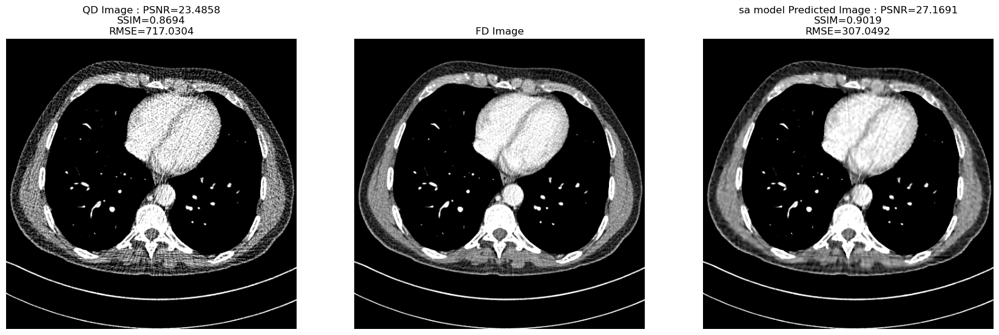

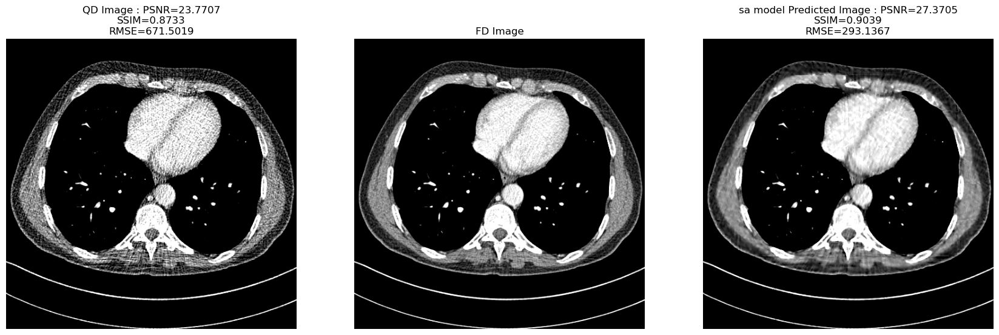

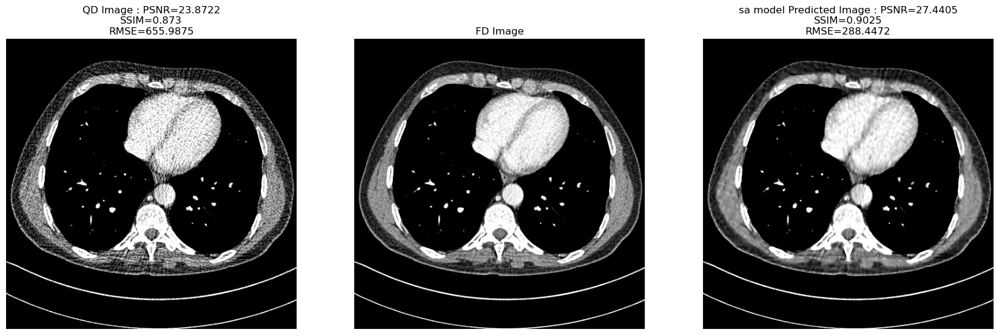

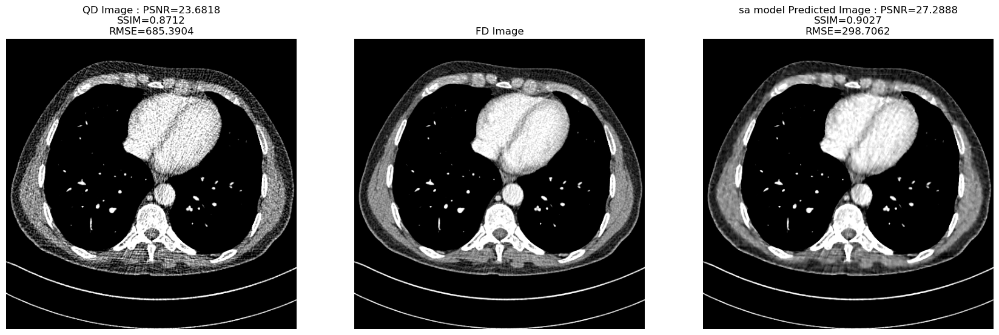

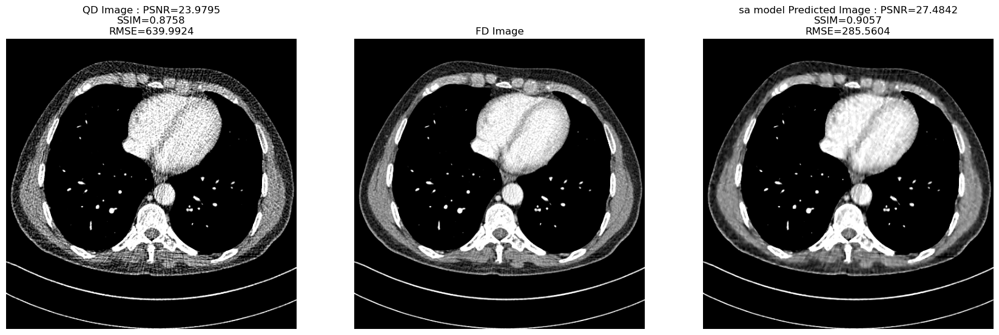

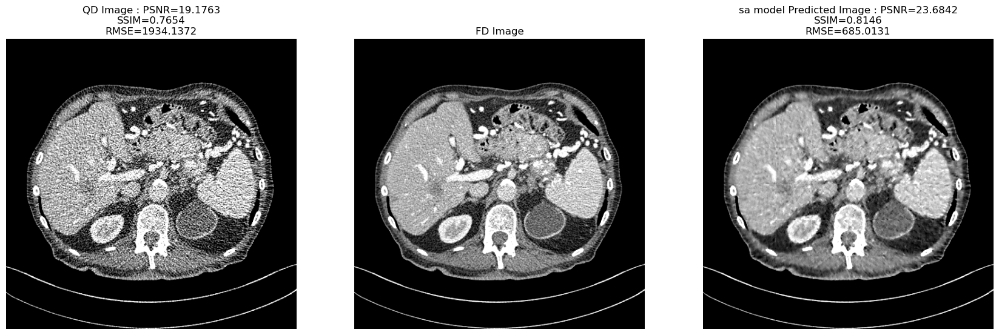

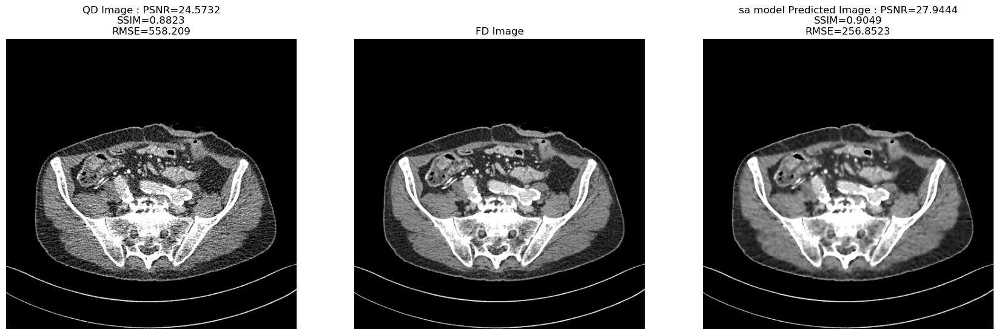

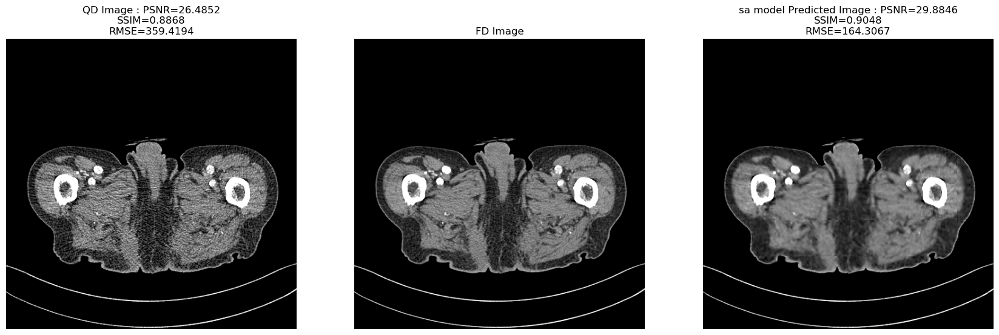

In [24]:
print('ax', extended_sa_prediction_patches.shape[0])
for i in range(1, int(extended_sa_predictions.shape[0])): 
    reconstructed_image = reconstruct_image_from_patches(extended_sa_prediction_patches[i * 64 : i * 64 + 64], num_patches_per_row=8)
    reconstructed_image = torch.from_numpy(np.expand_dims(reconstructed_image, axis=0).astype(np.float32))

  
    print(reconstructed_image.shape)
    _ot = torch.transpose(reconstructed_image, 1, 3)
    noisy = torch.from_numpy(np.expand_dims(extended_noisy_array[i], axis=-1).astype(np.float32)).to('cuda')
    noisy = torch.transpose(noisy, 1, 3)
    noisy = torch.transpose(noisy, 0, 2)

    print('ot shape : ', _ot.shape, ' noisy shape : ', noisy.shape)


    prediction_approx, prediction_high_freq = dwt(_ot.cuda())
    prediction_high_freq_low, prediction_high_freq_mid, prediction_high_freq_coarse = prediction_high_freq[0], prediction_high_freq[1], prediction_high_freq[2]

    noisy_approx, noisy_high_freq = dwt(noisy)

    noisy_high_freq_fine, noisy_high_freq_mid, noisy_high_freq_coarse = noisy_high_freq[0], noisy_high_freq[1] , noisy_high_freq[2]

    reconstructed_prediction_image_with_high_freq_swap = idwt((noisy_approx, noisy_high_freq))
    reconstructed_prediction_image_with_high_freq_swap = torch.transpose(reconstructed_prediction_image_with_high_freq_swap, 3, 1)


    #denoise_high_freq = torch.transpose(torch.from_numpy(denoised_high_freq), 1, 3)
    #denoised_noisy_approx, denoised_high_freq = dwt(denoise_high_freq.cuda())
    #noisy_high_freq_fine, noisy_high_freq_mid, noisy_high_freq_coarse = denoised_high_freq[0], denoised_high_freq[1] , denoised_high_freq[2]

    wavelet_high_freq_swapped = [None] * 3
    wavelet_high_freq_swapped[0] =noisy_high_freq_fine
    wavelet_high_freq_swapped[1] =prediction_high_freq_mid
    wavelet_high_freq_swapped[2] =prediction_high_freq_coarse

    reconstructed_prediction_image = idwt((prediction_approx,wavelet_high_freq_swapped))
    print('recon', reconstructed_prediction_image.shape)
    reconstructed_prediction_image = torch.transpose(reconstructed_prediction_image, 1, 3)
    print('recon', reconstructed_prediction_image.shape)
    extended_sa_prediction_patches = np.append(extended_sa_prediction_patches, reconstructed_prediction_image.detach().cpu().numpy())


visualize_predictions(sa_model, noisy_array, gt_array, len(gt_array), sa_predictions, "sa model")

In [25]:

extended_sa_metrics = get_average_metrics(extended_sa_predictions, extended_gt_array, extended_noisy_array)
extended_sa_metrics

Original average gt-noisy PSNR -> 0.23485824280503806
Predicted average gt-predicted PSNR -> 0.271696133324912
Original average gt-noisy SSIM -> 0.008693725347221537
Predicted average gt-predicted SSIM -> 0.009018385550522862
Original average gt-noisy MSE-> 7.170303764343262
Predicted average gt-predicted MSE-> 3.070143318460917


(0.2717, 0.009, 3.0701, 0.0368, 0.0003, -4.1002)

# Model 4 : ZB Model

In [26]:

sys.path.append('../denoising-models/hformer_pytorch')
from torchinfo import summary

from zb_model import ZModel 

z_model = ZModel(num_channels=4).cuda()
z_model.load_state_dict(torch.load('../denoising-models/novel_model_weights/zb_model_335.pth'))
z_model.eval()
print('model summary\n', summary(z_model, input_size=(64, 64, 64, 1)))

Using cache found in C:\Users\Tarun/.cache\torch\hub\mateuszbuda_brain-segmentation-pytorch_master
Using cache found in C:\Users\Tarun/.cache\torch\hub\mateuszbuda_brain-segmentation-pytorch_master


model summary
Layer (type:depth-idx)                        Output Shape              Param #
ZModel                                        [64, 64, 64, 1]           --
├─InputProjectionLayer: 1-1                   [64, 4, 64, 64]           --
│    └─Conv2d: 2-1                            [64, 4, 64, 64]           40
├─UNet: 1-2                                   [64, 4, 64, 64]           --
│    └─Sequential: 2-2                        [64, 4, 64, 64]           --
│    │    └─Conv2d: 3-1                       [64, 4, 64, 64]           144
│    │    └─BatchNorm2d: 3-2                  [64, 4, 64, 64]           8
│    │    └─ReLU: 3-3                         [64, 4, 64, 64]           --
│    │    └─Conv2d: 3-4                       [64, 4, 64, 64]           144
│    │    └─BatchNorm2d: 3-5                  [64, 4, 64, 64]           8
│    │    └─ReLU: 3-6                         [64, 4, 64, 64]           --
│    └─MaxPool2d: 2-3                         [64, 4, 32, 32]           --
│    └

In [27]:

z_prediction_patches = []

with torch.no_grad():    
    for i, data in enumerate(noisy_image_patches_array):
        noisy = data
    
        predictions = z_model(torch.unsqueeze(torch.from_numpy(noisy.numpy()), dim=0).to('cuda')).cpu()

        z_prediction_patches.append(predictions.detach().cpu())
    
z_prediction_patches = np.concatenate(z_prediction_patches, axis=0)
z_predictions = np.expand_dims(reconstruct_image_from_patches(z_prediction_patches[0:64], 8), axis=0)


for i in range(1, int(z_prediction_patches.shape[0] / 64)): 
    reconstructed_image = reconstruct_image_from_patches(z_prediction_patches[i * 64 : i * 64 + 64], num_patches_per_row=8)
    reconstructed_image = np.expand_dims(reconstructed_image, axis=0)

    z_predictions= np.append(z_predictions, reconstructed_image, axis=0)

extended_z_prediction_patches = []

with torch.no_grad():    
    for i, data in enumerate(extended_noisy_image_patches_array):
        noisy = data
    
        predictions = z_model(torch.unsqueeze(torch.from_numpy(noisy.numpy()), dim=0).to('cuda')).cpu()

        extended_z_prediction_patches.append(predictions.detach().cpu())

extended_z_prediction_patches = np.concatenate(extended_z_prediction_patches, axis=0)
extended_z_predictions = [np.expand_dims(reconstruct_image_from_patches(extended_z_prediction_patches[0:64], 8), axis=0)]
#print(extended_z_predictions.shape)




torch.Size([512, 512, 1, 1])
torch.Size([1, 512, 512, 1])
ot shape :  torch.Size([1, 1, 512, 512])  noisy shape :  torch.Size([1, 1, 512, 512]) recon shape :  torch.Size([512, 512, 1, 1])
recon torch.Size([1, 1, 512, 512])
recon torch.Size([1, 512, 512, 1])
torch.Size([512, 512, 1, 1])
torch.Size([1, 512, 512, 1])
ot shape :  torch.Size([1, 1, 512, 512])  noisy shape :  torch.Size([1, 1, 512, 512]) recon shape :  torch.Size([512, 512, 1, 1])
recon torch.Size([1, 1, 512, 512])
recon torch.Size([1, 512, 512, 1])
torch.Size([512, 512, 1, 1])
torch.Size([1, 512, 512, 1])
ot shape :  torch.Size([1, 1, 512, 512])  noisy shape :  torch.Size([1, 1, 512, 512]) recon shape :  torch.Size([512, 512, 1, 1])
recon torch.Size([1, 1, 512, 512])
recon torch.Size([1, 512, 512, 1])
torch.Size([512, 512, 1, 1])
torch.Size([1, 512, 512, 1])
ot shape :  torch.Size([1, 1, 512, 512])  noisy shape :  torch.Size([1, 1, 512, 512]) recon shape :  torch.Size([512, 512, 1, 1])
recon torch.Size([1, 1, 512, 512])
rec

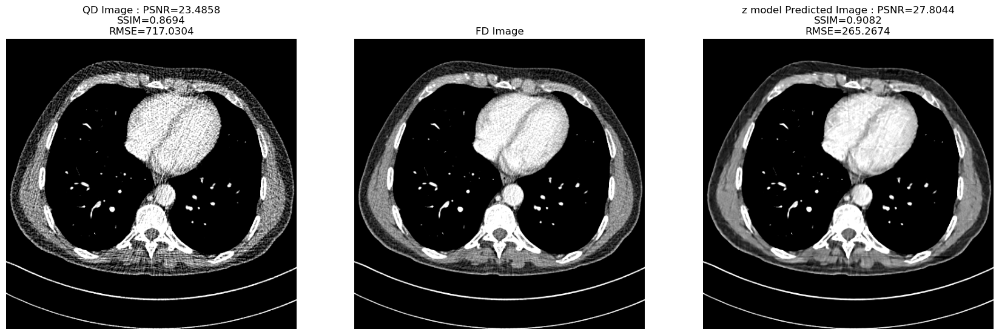

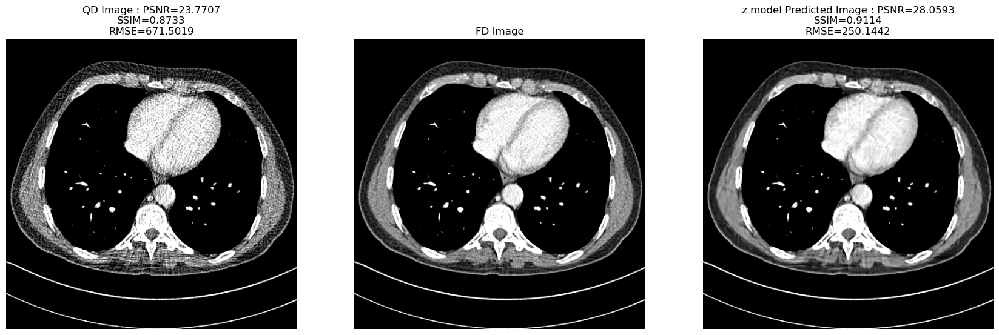

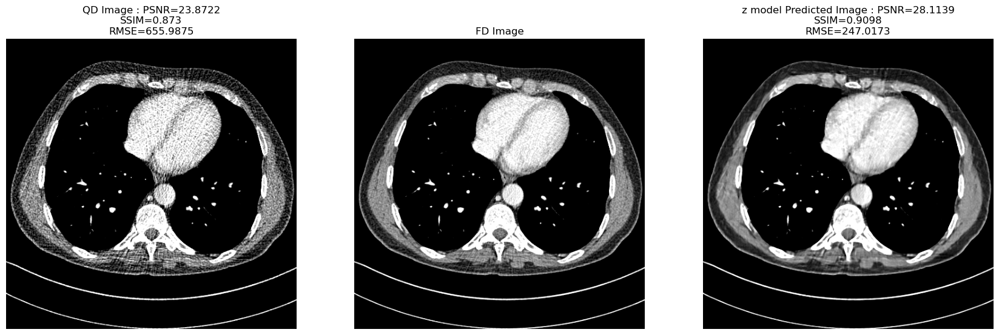

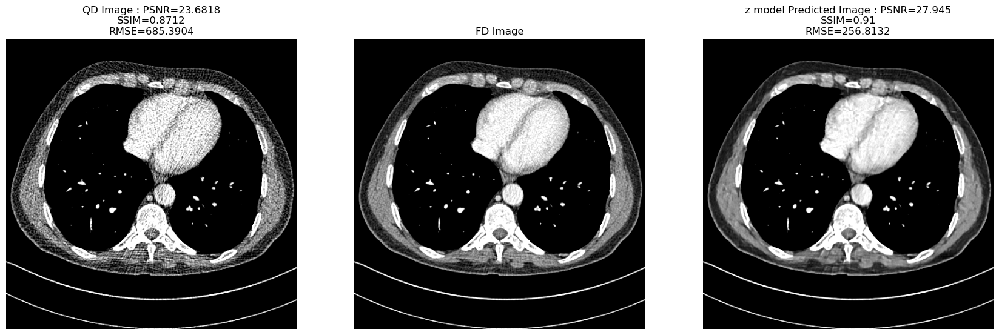

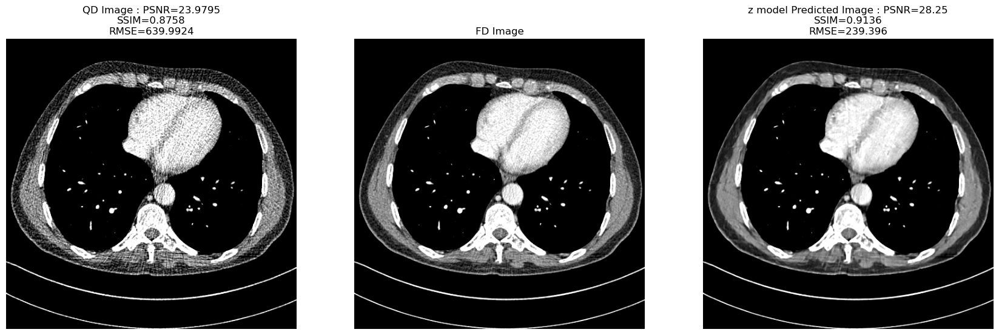

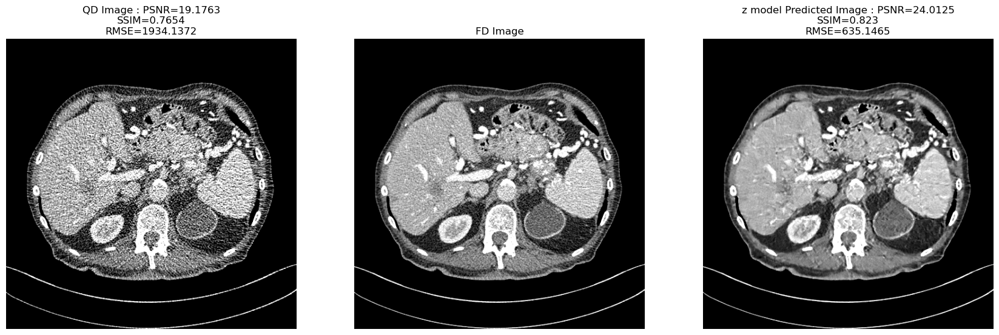

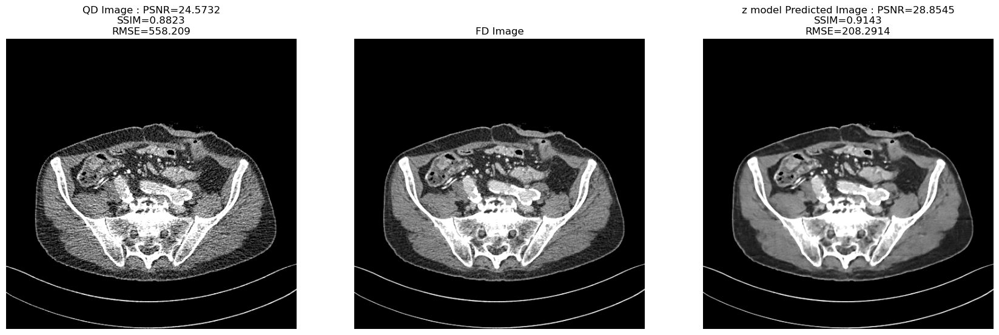

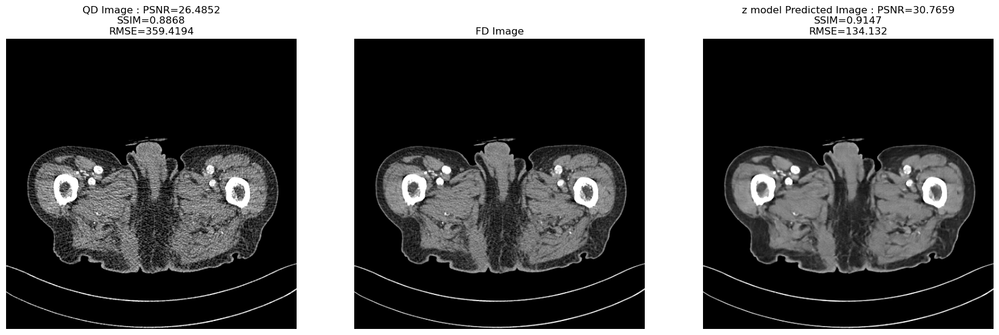

In [28]:

for i in range(1, int(extended_z_prediction_patches.shape[0] / 64)): 
    reconstructed_image = torch.from_numpy(np.expand_dims(reconstruct_image_from_patches(extended_z_prediction_patches[i * 64 : i * 64 + 64], num_patches_per_row=8), axis=-1).astype(np.float32))

    print(reconstructed_image.shape)
    _ot = torch.transpose(reconstructed_image, 0, 2)
    print(_ot.shape)
    _ot = torch.transpose(_ot, 1, 3)
    noisy = torch.from_numpy(np.expand_dims(extended_noisy_array[i], axis=-1).astype(np.float32)).to('cuda')
    noisy = torch.transpose(noisy, 1, 3)
    noisy = torch.transpose(noisy, 0, 2)

    print('ot shape : ', _ot.shape, ' noisy shape : ', noisy.shape, 'recon shape : ', reconstructed_image.shape)


    prediction_approx, prediction_high_freq = dwt(_ot.cuda())
    prediction_high_freq_low, prediction_high_freq_mid, prediction_high_freq_coarse = prediction_high_freq[0], prediction_high_freq[1], prediction_high_freq[2]

    noisy_approx, noisy_high_freq = dwt(noisy)

    noisy_high_freq_fine, noisy_high_freq_mid, noisy_high_freq_coarse = noisy_high_freq[0], noisy_high_freq[1] , noisy_high_freq[2]

    reconstructed_prediction_image_with_high_freq_swap = idwt((noisy_approx, noisy_high_freq))
    reconstructed_prediction_image_with_high_freq_swap = torch.transpose(reconstructed_prediction_image_with_high_freq_swap, 3, 1)


    #denoise_high_freq = torch.transpose(torch.from_numpy(denoised_high_freq), 1, 3)
    #denoised_noisy_approx, denoised_high_freq = dwt(denoise_high_freq.cuda())
    #noisy_high_freq_fine, noisy_high_freq_mid, noisy_high_freq_coarse = denoised_high_freq[0], denoised_high_freq[1] , denoised_high_freq[2]

    wavelet_high_freq_swapped = [None] * 3
    wavelet_high_freq_swapped[0] =noisy_high_freq_fine
    wavelet_high_freq_swapped[1] =prediction_high_freq_mid
    wavelet_high_freq_swapped[2] =prediction_high_freq_coarse

    reconstructed_prediction_image = idwt((prediction_approx,wavelet_high_freq_swapped))
    print('recon', reconstructed_prediction_image.shape)
    reconstructed_prediction_image = torch.transpose(reconstructed_prediction_image, 1, 3)
    print('recon', reconstructed_prediction_image.shape)
    extended_z_predictions.append(reconstructed_prediction_image.detach().cpu().numpy())

visualize_predictions(z_model, noisy_array, gt_array, len(gt_array), z_predictions, "z model")

In [29]:

extended_z_predictions = np.concatenate(extended_z_predictions, axis=0)
print('i', extended_z_predictions.shape)
extended_z_metrics = get_average_metrics(extended_z_predictions, extended_gt_array, extended_noisy_array)
extended_z_metrics

i (100, 512, 512, 1)
Original average gt-noisy PSNR -> 22.75797969597923
Predicted average gt-predicted PSNR -> 8.596232072128496
Original average gt-noisy SSIM -> 0.82834844080363
Predicted average gt-predicted SSIM -> 0.2675301953610465
Original average gt-noisy MSE-> 937.7143929672242
Predicted average gt-predicted MSE-> 23381.31253933937


(8.5962, 0.2675, 23381.3125, -14.1617, -0.5608, 22443.5981)

# Model 5 : WB Model

In [30]:

sys.path.append('../denoising-models/hformer_pytorch')
from torchinfo import summary

from w_b_model import WModel 

w_model = WModel(num_channels=8).cuda()
w_model.load_state_dict(torch.load('../denoising-models/novel_model_weights/wb_model_662.pth'))
w_model.eval()
print('model summary\n', summary(w_model, input_size=(64, 64, 64, 1)))

Using cache found in C:\Users\Tarun/.cache\torch\hub\mateuszbuda_brain-segmentation-pytorch_master
Using cache found in C:\Users\Tarun/.cache\torch\hub\mateuszbuda_brain-segmentation-pytorch_master


model summary
Layer (type:depth-idx)                   Output Shape              Param #
WModel                                   [64, 64, 64, 1]           --
├─InputProjectionLayer: 1-1              [64, 8, 64, 64]           --
│    └─Conv2d: 2-1                       [64, 8, 64, 64]           80
├─UNet: 1-2                              [64, 8, 64, 64]           --
│    └─Sequential: 2-2                   [64, 8, 64, 64]           --
│    │    └─Conv2d: 3-1                  [64, 8, 64, 64]           576
│    │    └─BatchNorm2d: 3-2             [64, 8, 64, 64]           16
│    │    └─ReLU: 3-3                    [64, 8, 64, 64]           --
│    │    └─Conv2d: 3-4                  [64, 8, 64, 64]           576
│    │    └─BatchNorm2d: 3-5             [64, 8, 64, 64]           16
│    │    └─ReLU: 3-6                    [64, 8, 64, 64]           --
│    └─MaxPool2d: 2-3                    [64, 8, 32, 32]           --
│    └─Sequential: 2-4                   [64, 16, 32, 32]          --

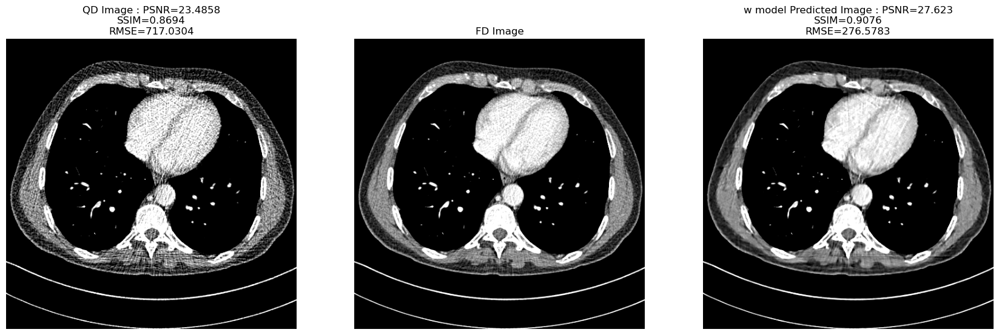

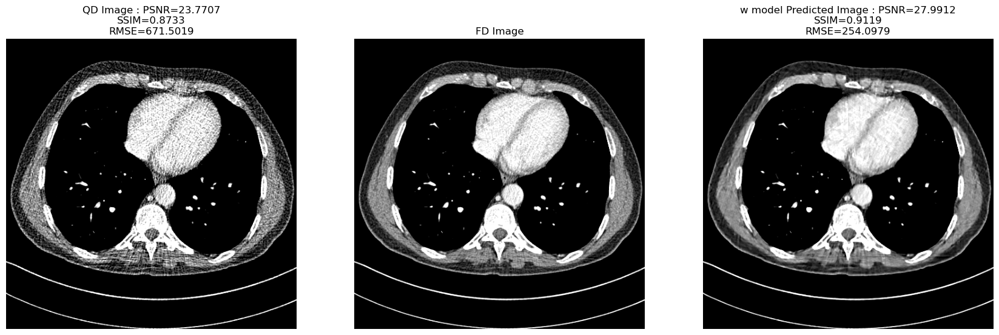

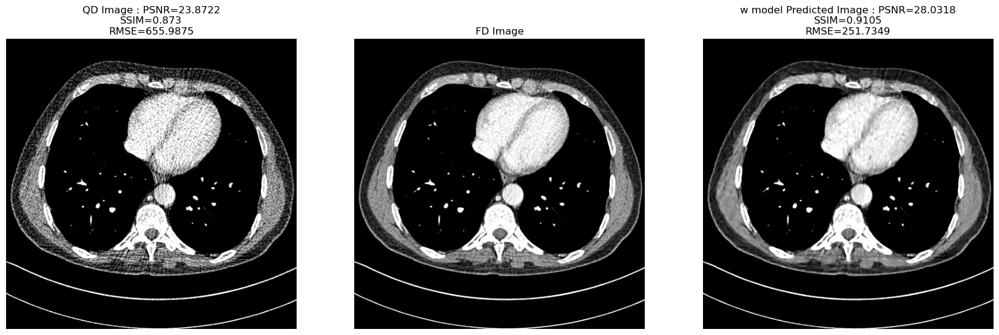

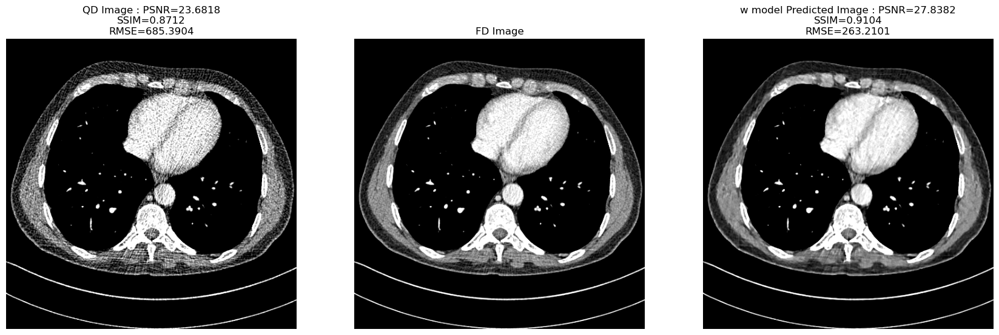

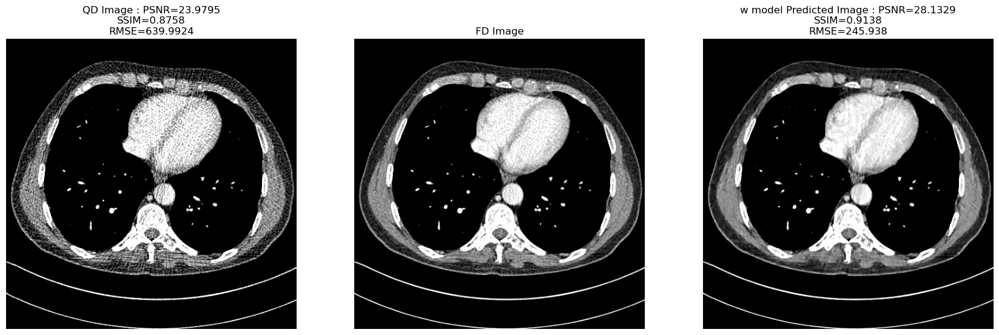

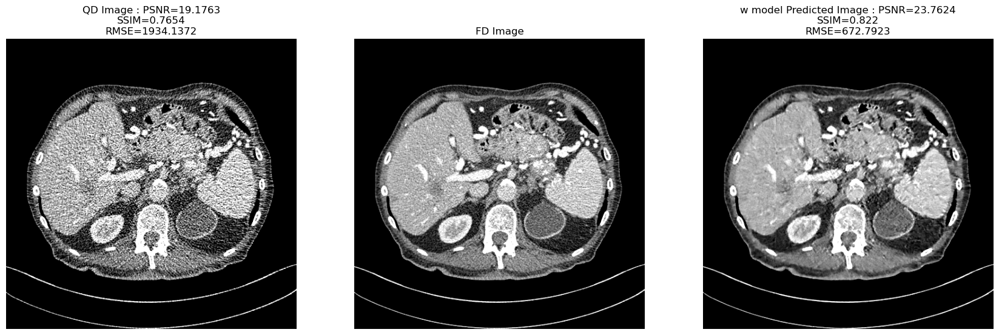

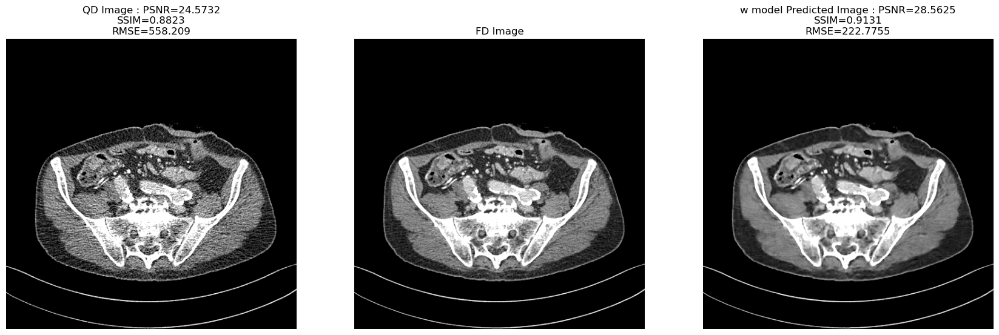

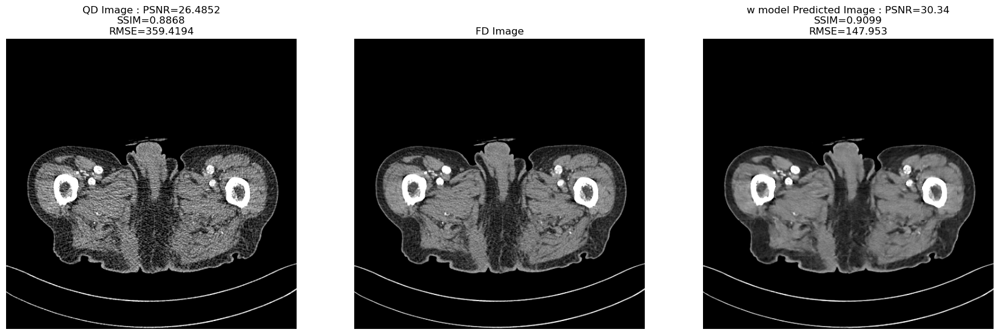

In [31]:

w_prediction_patches = []

with torch.no_grad():    
    for i, data in enumerate(noisy_image_patches_array):
        noisy = data
    
        predictions = w_model(torch.unsqueeze(torch.from_numpy(noisy.numpy()), dim=0).to('cuda')).cpu()

        w_prediction_patches.append(predictions.detach().cpu())
    
w_prediction_patches = np.concatenate(w_prediction_patches, axis=0)

w_predictions = np.expand_dims(reconstruct_image_from_patches(w_prediction_patches[0:64], 8), axis=0)


for i in range(1, int(w_prediction_patches.shape[0] / 64)): 
    reconstructed_image = reconstruct_image_from_patches(w_prediction_patches[i * 64 : i * 64 + 64], num_patches_per_row=8)
    reconstructed_image = np.expand_dims(reconstructed_image, axis=0)

    w_predictions= np.append(w_predictions, reconstructed_image, axis=0)

visualize_predictions(w_model, noisy_array, gt_array, len(gt_array), w_predictions, "w model")

In [33]:

# W model with wavelet
from pytorch_wavelets import DTCWTForward, DTCWTInverse
dwt = DTCWTForward(J=3).cuda()
idwt = DTCWTInverse().cuda()
wavelet_w_model_prediction_patches =[]


with torch.no_grad():
    for i in range(extended_noisy_image_patches_array.shape[0] // 64):
        noisy = extended_noisy_image_patches_array[i * 64 : i * 64 + 64]
        noisy = torch.from_numpy(noisy.cpu().numpy()).to('cuda')
        prediction = w_model(noisy)

        prediction_img = torch.transpose(prediction, 1, 3)
        transposed_noisy_image = torch.transpose(noisy, 1, 3)

        prediction_approx, prediction_high_freq = dwt(prediction_img.cuda())
        prediction_high_freq_low, prediction_high_freq_mid, prediction_high_freq_coarse = prediction_high_freq[0], prediction_high_freq[1], prediction_high_freq[2]

        noisy_approx, noisy_high_freq = dwt(transposed_noisy_image.cuda())

        noisy_high_freq_fine, noisy_high_freq_mid, noisy_high_freq_coarse = noisy_high_freq[0], noisy_high_freq[1] , noisy_high_freq[2]

        reconstructed_prediction_image_with_high_freq_swap = idwt((noisy_approx, noisy_high_freq))
        reconstructed_prediction_image_with_high_freq_swap = torch.transpose(reconstructed_prediction_image_with_high_freq_swap, 3, 1)


        #denoise_high_freq = torch.transpose(torch.from_numpy(denoised_high_freq), 1, 3)
        #denoised_noisy_approx, denoised_high_freq = dwt(denoise_high_freq.cuda())
        #noisy_high_freq_fine, noisy_high_freq_mid, noisy_high_freq_coarse = denoised_high_freq[0], denoised_high_freq[1] , denoised_high_freq[2]

        wavelet_high_freq_swapped = [None] * 3
        wavelet_high_freq_swapped[0] =noisy_high_freq_fine
        wavelet_high_freq_swapped[1] =prediction_high_freq_mid
        wavelet_high_freq_swapped[2] =prediction_high_freq_coarse

        reconstructed_prediction_image = idwt((prediction_approx,wavelet_high_freq_swapped))
        reconstructed_prediction_image = torch.transpose(reconstructed_prediction_image, 1, 3)
        wavelet_w_model_prediction_patches.append(reconstructed_prediction_image.detach().cpu().numpy())

wavelet_w_predictions = [None] * extended_noisy_array.shape[0]
def reconstruct(patches,  num_images):
    num_patches_per_image = patches.shape[0] // num_images
    for i in range(num_images):
        
        image_patches = patches[i * num_patches_per_image:i * num_patches_per_image + num_patches_per_image]
        
        reconstruct_image = (reconstruct_image_from_patches(image_patches, 8))
        wavelet_w_predictions[i]  = reconstruct_image
wavelet_w_model_prediction_patches = np.concatenate(wavelet_w_model_prediction_patches)
print(wavelet_w_model_prediction_patches.shape)
reconstruct(wavelet_w_model_prediction_patches, extended_gt_array.shape[0])


(6400, 64, 64, 1)


In [34]:
print(len(wavelet_w_predictions),  extended_gt_array.shape)

100 (100, 512, 512, 1)


In [35]:

extended_w_metrics = get_average_metrics(wavelet_w_predictions, extended_gt_array, extended_noisy_array)

Original average gt-noisy PSNR -> 22.75797969597923
Predicted average gt-predicted PSNR -> 25.675223677971253
Original average gt-noisy SSIM -> 0.82834844080363
Predicted average gt-predicted SSIM -> 0.8617489854559953
Original average gt-noisy MSE-> 937.7143929672242
Predicted average gt-predicted MSE-> 475.8982649989202


In [36]:
extended_w_metrics

(25.6752, 0.8617, 475.8983, 2.9172, 0.0334, -461.8161)

## Part V : Side by side comparison of all models

In [37]:
from prettytable import PrettyTable

pt = PrettyTable()
pt.field_names = ["Model", "PSNR", "SSIM", "MSE", "PSNR Improvement", "SSIM improvement", "MSE Improvement", "Num Parameter"]

#hformer_metrics = get_average_metrics(hformer_predictions, gt_array, noisy_array)
#x_metrics= get_average_metrics(np.concatenate(x_model_prediction_patches, axis=0), gt_array, noisy_array)
#y_metrics= get_average_metrics(np.concatenate(y_model_prediction_patches, axis=0), gt_array, noisy_array)
#sa_metrics = get_average_metrics(sa_predictions, gt_array, noisy_array)
#z_metrics = get_average_metrics(z_predictions, gt_array, noisy_array)
#w_metrics = get_average_metrics(w_predictions, gt_array, noisy_array)





In [38]:
hformer_metrics = extended_hformer_metrics
x_metrics = extended_x_metrics
y_metrics = extended_y_metrics
sa_metrics = extended_sa_metrics
z_metrics = extended_z_metrics
w_metrics = extended_w_metrics

pt.add_row(["Original X-y pairs (No Model)","21.97","0.78911", '-', '-', "-", "-", "-"])
pt.add_row(["Hformer",str(hformer_metrics[0]), str(hformer_metrics[1]), str(round(hformer_metrics[2], 4)), str(round(hformer_metrics[3], 4)), str(round(hformer_metrics[4] * 100, 4)), str(hformer_metrics[5]) + '%', '1,511,681'])
pt.add_row(["XB Model",str(x_metrics[0]), str(x_metrics[1]), str(round(x_metrics[2], 4)), str(round(x_metrics[3], 4)), str(round(x_metrics[4] * 100, 4)), str(x_metrics[5]) + '%', '1306'])
pt.add_row(["YB Model",str(y_metrics[0]), str(y_metrics[1]), str(round(y_metrics[2], 4)), str(round(y_metrics[3], 4)), str(round(y_metrics[4] * 100, 4)), str(y_metrics[5]) + '%', '145,453'])
pt.add_row(["SAB Model",str(sa_metrics[0]), str(sa_metrics[1]), str(round(sa_metrics[2], 4)), str(round(sa_metrics[3], 4)), str(round(sa_metrics[4] * 100, 4)), str(sa_metrics[5]) + '%', '15,345'])
pt.add_row(["ZB Model",str(z_metrics[0]), str(z_metrics[1]), str(round(z_metrics[2], 4)), str(round(z_metrics[3], 4)), str(round(z_metrics[4] * 100, 4)), str(z_metrics[5]) + '%', '245,905'])
pt.add_row(["WB Model",str(w_metrics[0]), str(w_metrics[1]), str(round(w_metrics[2], 4)), str(round(w_metrics[3], 4)), str(round(w_metrics[4] * 100, 4)), str(w_metrics[5]) + '%', '977,233'])

print(pt)

+-------------------------------+---------+---------+------------+------------------+------------------+-----------------+---------------+
|             Model             |   PSNR  |   SSIM  |    MSE     | PSNR Improvement | SSIM improvement | MSE Improvement | Num Parameter |
+-------------------------------+---------+---------+------------+------------------+------------------+-----------------+---------------+
| Original X-y pairs (No Model) |  21.97  | 0.78911 |     -      |        -         |        -         |        -        |       -       |
|            Hformer            | 27.5236 |  0.8724 |  304.4095  |      4.7656      |       4.4        |    -633.3049%   |   1,511,681   |
|            XB Model           | 23.9291 |  0.8255 |  696.5893  |      1.1711      |      -0.28       |    -241.1251%   |      1306     |
|            YB Model           | 25.3033 |  0.8289 |  512.0819  |      2.5454      |       0.06       |    -425.6324%   |    145,453    |
|           SAB Model      

## Part 6 : Output of predictions of all 4 models side by side for direct visualize comparison

In [39]:
def visualize_predictions_all_models(X_test, y_test, n, hformer_predictions, x_predictions, y_predictions, sa_predictions, z_predictions, w_predictions):
    random_numbers = list(range(n))  # not very random
    for i in random_numbers:
        noisy_image = X_test[i]
        gt_image = y_test[i]

        hformer_pred = hformer_predictions[i]
        x_pred = x_predictions[i]
        y_pred = y_predictions[i]
        sa_pred = sa_predictions[i]
        z_pred = z_predictions[i]
        w_pred = w_predictions[i]

        models = ["HFORMER", "X", "Y", "SA",  "Z", "W"]
        predictions = [hformer_pred, x_pred, y_pred, sa_pred, z_pred, w_pred]

        # Display QD and FD images
        f, axarr = plt.subplots(1, 2 + len(models), figsize=(41,41))

        psnr_qd =  calculate_psnr(trunc(denormalize(gt_image)),  trunc(denormalize(noisy_image)))
        ssim_qd =calculate_ssim(trunc(denormalize(gt_image)), trunc(denormalize(noisy_image)))
        rmse_qd = calculate_rmse(trunc(denormalize(gt_image)), trunc(denormalize(noisy_image)))

        axarr[0].imshow(trunc(denormalize(noisy_image)), cmap='gray', vmin=-160.0, vmax=240.0)
        axarr[0].set_title("QD Image\nPSNR={}\nSSIM={}\nMSE={}".format(round(psnr_qd, 4), round(ssim_qd, 4), round(rmse_qd, 4)))

        axarr[0].set_axis_off()
        axarr[1].imshow(trunc(denormalize(gt_image)), cmap='gray', vmin=-160.0, vmax=240.0)
        axarr[1].set_title("FD Image")
        axarr[1].set_axis_off()

        for j, (model_name, predicted_image) in enumerate(zip(models, predictions), start=2):
            if predicted_image.shape[-1] == 3:
                predicted_image = rgb2gray(predicted_image)

            psnr_recon = calculate_psnr(trunc(denormalize(gt_image)), trunc(denormalize(predicted_image)))
            ssim_recon = calculate_ssim(trunc(denormalize(gt_image)), trunc(denormalize(predicted_image)))
            rmse_recon = calculate_rmse(trunc(denormalize(gt_image)), trunc(denormalize(predicted_image)))

            psnr_recon = round(psnr_recon, 4)
            ssim_recon = round(ssim_recon, 4)
            mse_recon = round(rmse_recon, 4)

            axarr[j].imshow(trunc(denormalize(predicted_image)), cmap='gray', vmin=-160.0, vmax=240.0)
            axarr[j].set_title("{}\nPSNR={}\nSSIM={}\nMSE={}".format(model_name, psnr_recon, ssim_recon, mse_recon))
            axarr[j].set_axis_off()

        plt.savefig('../../output/novel_comparison_b_wavelet/combined_outputs_image_index_{}.png'.format(i))
        plt.show()

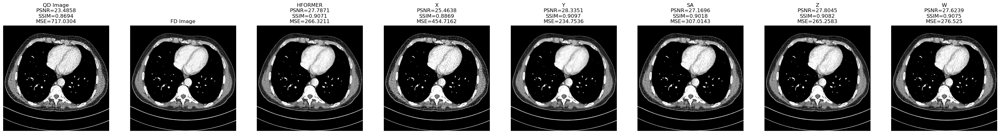

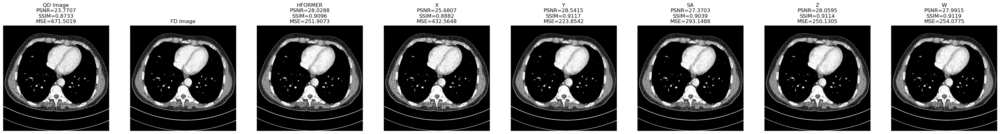

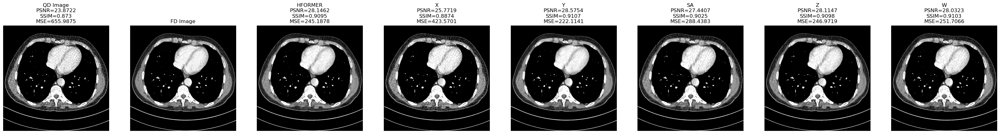

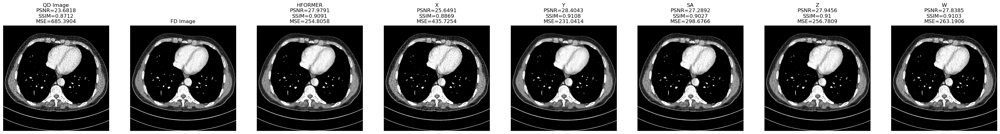

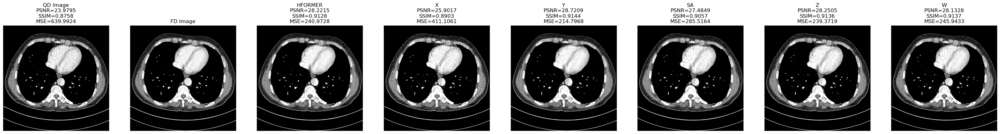

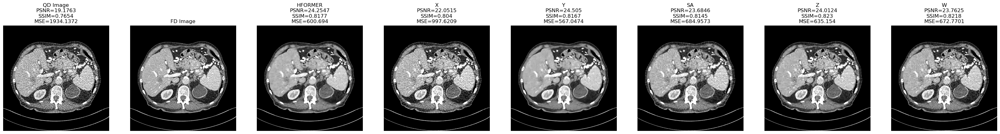

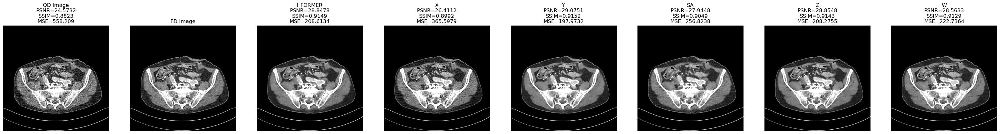

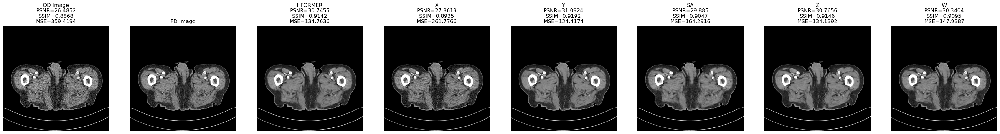

In [40]:

visualize_predictions_all_models(noisy_array, gt_array, len(gt_array), hformer_predictions, np.concatenate(x_model_prediction_patches, axis=0), np.concatenate(y_model_prediction_patches, axis=0), sa_predictions, z_predictions, w_predictions)